In [1]:
import mne
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import io
import seaborn as sns

# Author: Martin Luessi <mluessi@nmr.mgh.harvard.edu>
# License: BSD (3-clause)
from matplotlib.colors import TwoSlopeNorm

import os.path as op
from mne.time_frequency import tfr_multitaper
from mne.stats import permutation_cluster_1samp_test as pcluster_test

from mne_connectivity import spectral_connectivity_epochs, seed_target_indices
from mne.datasets import sample
from mne_connectivity.viz import plot_sensors_connectivity
from mne.stats import permutation_cluster_test
from scipy import stats as stats
from functools import partial

print(__doc__)

Automatically created module for IPython interactive environment


In [2]:
dict015= {'FP1':'eeg','FP2':'eeg','AF7':'eeg','AF3':'eeg','AFz':'eeg','AF4':'eeg','AF8':'eeg','F7':'eeg','F3':'eeg',
          'Fz':'eeg','F4':'eeg','F8':'eeg','FT9':'eeg','FC5':'eeg','FC1':'eeg','FC2':'eeg','FC6':'eeg','FT10':'eeg',
          'T7':'eeg','C3':'eeg','Cz':'eeg','C4':'eeg','T8':'eeg','TP9':'eeg','CP5':'eeg','CP1':'eeg', 'CP2':'eeg',
          'CP6':'eeg','TP10':'eeg','P7':'eeg','P3':'eeg','Pz':'eeg','P4':'eeg','P8':'eeg', 'O1':'eeg','O2':'eeg',
          'DBS1-2':'dbs','DBS2-3':'dbs','DBS3-4':'dbs','DBS4-5':'dbs','DBS5-6':'dbs','DBS6-7':'dbs','DBS7-8':'dbs',
          'mean(DBS1-DBS2, DBS2-DBS3, DBS3-DBS4, DBS4-DBS5, DBS5-DBS6, DBS6-DBS7, DBS7-DBS8)':'misc',
          'DynL(lc)':'misc','DynR(lc)':'misc','EmgL':'emg','EmgR':'emg','EmgL(lc)':'emg','EmgR(lc)':'emg'}

dict013_imp = {'FP1':'eeg','FP2':'eeg','AF7':'eeg','AF3':'eeg','AFz':'eeg','AF4':'eeg','AF8':'eeg','F7':'eeg','F3':'eeg',
          'Fz':'eeg','F4':'eeg','F8':'eeg','FC5':'eeg','FC1':'eeg','FC2':'eeg','FC6':'eeg',
          'T7':'eeg','C3':'eeg','Cz':'eeg','C4':'eeg','T8':'eeg','FT9':'eeg','CP5':'eeg','CP1':'eeg', 'CP2':'eeg',
          'CP6':'eeg','FT10':'eeg','TP9':'eeg','P3':'eeg','Pz':'eeg','P4':'eeg','P8':'eeg', 'O1':'eeg','O2':'eeg',
          'DBS1-2':'dbs','DBS2-3':'dbs','DBS3-4':'dbs','DBS4-5':'dbs','DBS5-6':'dbs','DBS6-7':'dbs','DBS7-8':'dbs',
          'mean(DBS1-DBS2, DBS2-DBS3, DBS3-DBS4, DBS4-DBS5, DBS5-DBS6, DBS6-DBS7, DBS7-DBS8)':'misc',
          'DynL(lc)':'misc','DynR(lc)':'misc','EmgL':'emg','EmgR':'emg','EmgL(lc)':'emg','EmgR(lc)':'emg'}

dict013_exp = dict015

dict011_imp = {'FP1':'eeg','FP2':'eeg','AF8':'eeg','AF4':'eeg','AFz':'eeg','AF3':'eeg','AF7':'eeg','F8':'eeg','F4':'eeg','Fz':'eeg','F3':'eeg',
              'F7':'eeg','FC6':'eeg','FC2':'eeg','FC1':'eeg','FC5':'eeg','T8':'eeg','C4':'eeg','Cz':'eeg','C3':'eeg','T7':'eeg','FT10':'eeg',
               'CP6':'eeg','CP2':'eeg','CP1':'eeg', 'CP5':'eeg', 'FT9':'eeg', 'TP10':'eeg','P4':'eeg','Pz':'eeg','P3':'eeg','P7':'eeg','O2':'eeg',
               'O1':'eeg', 'DBS1-2':'dbs','DBS2-3':'dbs','DBS3-4':'dbs','DBS4-5':'dbs','DBS5-6':'dbs','DBS6-7':'dbs','DBS7-8':'dbs',
              'mean(DBS1-DBS2, DBS2-DBS3, DBS3-DBS4, DBS4-DBS5, DBS5-DBS6, DBS6-DBS7, DBS7-DBS8)':'misc',
             'DynR(lc)':'misc', 'DynL(lc)':'misc','EmgR':'emg','EmgL':'emg','EmgR(lc)':'emg','EmgL(lc)':'emg'}

dict011_exp = {'FP1':'eeg','FP2':'eeg','AF8':'eeg','AF4':'eeg','AFz':'eeg','AF3':'eeg','AF7':'eeg','F8':'eeg','F4':'eeg','Fz':'eeg','F3':'eeg',
              'F7':'eeg','FT10':'eeg', 'FC6':'eeg','FC2':'eeg','FC1':'eeg','FC5':'eeg','FT9':'eeg','T8':'eeg','C4':'eeg','Cz':'eeg','C3':'eeg',
               'T7':'eeg','TP10':'eeg','CP6':'eeg','CP2':'eeg','CP1':'eeg', 'CP5':'eeg', 'TP9':'eeg', 'P8':'eeg','P4':'eeg','Pz':'eeg',
               'P3':'eeg','P7':'eeg','O2':'eeg', 'O1':'eeg', 'DBS1-2':'dbs','DBS2-3':'dbs','DBS3-4':'dbs','DBS4-5':'dbs','DBS5-6':'dbs',
               'DBS6-7':'dbs','DBS7-8':'dbs', 'mean(DBS1-DBS2, DBS2-DBS3, DBS3-DBS4, DBS4-DBS5, DBS5-DBS6, DBS6-DBS7, DBS7-DBS8)':'misc',
             'DynR(lc)':'misc', 'DynL(lc)':'misc','EmgR':'emg','EmgL':'emg','EmgR(lc)':'emg','EmgL(lc)':'emg'}
           
    
#'DBS1-234':'dbs','DBS234-567':'dbs','DBS567-8':'dbs','mean(DBS1-234, DBS234-567, DBS567-8)':'dbs',

dict08_imp = {'FP1':'eeg','FP2':'eeg','AF8':'eeg','AF4':'eeg','AFz':'eeg','AF3':'eeg','AF7':'eeg','F8':'eeg',
                'F4':'eeg','Fz':'eeg','F3':'eeg','F7':'eeg','FT10':'eeg','FC6':'eeg',
                'FC2':'eeg','FC1':'eeg','FC5':'eeg','FT9':'eeg','T8':'eeg','C4':'eeg','Cz':'eeg','C3':'eeg',
                'T7':'eeg','TP10':'eeg','CP6':'eeg','CP2':'eeg','CP1':'eeg','CP5':'eeg','TP9':'eeg','P4':'eeg',
                'Pz':'eeg','P3':'eeg','O2':'eeg','O1':'eeg',
                'DBS1-2':'dbs', 'DBS1-3':'dbs', 'DBS1-4':'dbs','DBS2-5':'dbs', 'DBS3-6':'dbs', 
                'DBS4-7':'dbs', 'DBS5-8':'dbs', 'DBS6-8':'dbs', 'DBS7-8':'dbs',              
                'mean(DBS1-2, DBS1-3, DBS1-4, DBS2-5, DBS3-6, DBS4-7, DBS5-8, DBS6-8, DBS7-8)':'misc',             
                'DynR(lc)':'misc',
                'DynL(lc)':'misc','EmgR':'emg','EmgL':'emg','EmgR(lc)':'emg','EmgL(lc)':'emg'}

dict08_exp = {'FP1':'eeg','FP2':'eeg','AF8':'eeg','AF4':'eeg','AFz':'eeg','AF3':'eeg','AF7':'eeg','F8':'eeg',
                'F4':'eeg','Fz':'eeg','F3':'eeg','F7':'eeg','FC6':'eeg', 'FC2':'eeg','FC1':'eeg','FC5':'eeg',
                'T8':'eeg','C4':'eeg','Cz':'eeg','C3':'eeg', 'T7':'eeg','FT10':'eeg', 'CP6':'eeg','CP2':'eeg',
                'CP1':'eeg','CP5':'eeg','FT9':'eeg','TP10':'eeg', 'P4':'eeg','Pz':'eeg','P3':'eeg','P7':'eeg',
                'O2':'eeg','O1':'eeg',
                'DBS1-2':'dbs', 'DBS1-3':'dbs', 'DBS1-4':'dbs','DBS2-5':'dbs', 'DBS3-6':'dbs', 
                'DBS4-7':'dbs', 'DBS5-8':'dbs', 'DBS6-8':'dbs', 'DBS7-8':'dbs',              
                'mean(DBS1-2, DBS1-3, DBS1-4, DBS2-5, DBS3-6, DBS4-7, DBS5-8, DBS6-8, DBS7-8)':'misc',         
                'DynR(lc)':'misc',
                'DynL(lc)':'misc','EmgR':'emg','EmgL':'emg','EmgR(lc)':'emg','EmgL(lc)':'emg'}

dict07_imp= {'FP1':'eeg','FP2':'eeg','AF8':'eeg','AF4':'eeg','AFz':'eeg','AF3':'eeg','AF7':'eeg','F8':'eeg',
                'F4':'eeg','Fz':'eeg','F3':'eeg','F7':'eeg','FT10':'eeg','FC6':'eeg',
                'FC2':'eeg','FC1':'eeg','FC5':'eeg','FT9':'eeg','T8':'eeg','C4':'eeg','Cz':'eeg','C3':'eeg',
                'T7':'eeg','TP10':'eeg','CP6':'eeg','CP2':'eeg','CP1':'eeg','CP5':'eeg','TP9':'eeg','P4':'eeg',
                'Pz':'eeg','P3':'eeg','O2':'eeg','O1':'eeg',
                'DBS1-2':'dbs', 'DBS1-3':'dbs', 'DBS1-4':'dbs','DBS2-5':'dbs', 'DBS3-6':'dbs',
                'DBS4-7':'dbs', 'DBS5-8':'dbs', 'DBS6-8':'dbs', 'DBS7-8':'dbs',
                'mean(DBS1-2, DBS1-3, DBS1-4, DBS2-5, DBS3-6, DBS4-7, DBS5-8, DBS6-8, DBS7-8)':'misc',
                'DynR':'misc','DynL':'misc','DynR(lc)':'misc',
                'DynL(lc)':'misc','EmgR':'emg','EmgL':'emg','EmgR(lc)':'emg','EmgL(lc)':'emg'}

dict07_exp= {'FP1':'eeg','FP2':'eeg','AF8':'eeg','AF4':'eeg','AFz':'eeg','AF3':'eeg','AF7':'eeg','F8':'eeg',
                'F4':'eeg','Fz':'eeg','F3':'eeg','F7':'eeg','FT10':'eeg','FC6':'eeg',
                'FC2':'eeg','FC1':'eeg','FC5':'eeg','FT9':'eeg','T8':'eeg','C4':'eeg','Cz':'eeg','C3':'eeg',
                'T7':'eeg','TP10':'eeg','CP6':'eeg','CP2':'eeg','CP1':'eeg','CP5':'eeg','TP9':'eeg','P8':'eeg','P4':'eeg',
                'Pz':'eeg','P3':'eeg','P7':'eeg','O2':'eeg','O1':'eeg',
                'DBS1-2':'dbs', 'DBS1-3':'dbs', 'DBS1-4':'dbs','DBS2-5':'dbs', 'DBS3-6':'dbs',
                'DBS4-7':'dbs', 'DBS5-8':'dbs', 'DBS6-8':'dbs', 'DBS7-8':'dbs',
                'mean(DBS1-2, DBS1-3, DBS1-4, DBS2-5, DBS3-6, DBS4-7, DBS5-8, DBS6-8, DBS7-8)':'misc',
                'DynR(lc)':'misc',
                'DynL(lc)':'misc','EmgR':'emg','EmgL':'emg','EmgR(lc)':'emg','EmgL(lc)':'emg'}

dict_eog= {'FP1':'eog'}

Adding metadata with 9 columns
404 matching events found
No baseline correction applied
Setting up band-pass filter from 0.05 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.05
- Lower transition bandwidth: 0.05 Hz (-6 dB cutoff frequency: 0.03 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 13201 samples (66.005 s)



C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:39: RuntimeWarning: The unit for channel(s) AF3, AF4, AF7, AF8, AFz, C3, C4, CP1, CP2, CP5, CP6, Cz, DBS1-2, DBS1-3, DBS1-4, DBS2-5, DBS3-6, DBS4-7, DBS5-8, DBS6-8, DBS7-8, EmgL, EmgL(lc), EmgR, EmgR(lc), F3, F4, F7, F8, FC1, FC2, FC5, FC6, FP1, FP2, FT10, FT9, Fz, O1, O2, P3, P4, Pz, T7, T8, TP10, TP9 has changed from NA to V.
  epochs.set_channel_types(dict1)
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:45: RuntimeWarning: filter_length (13201) is longer than the signal (1801), distortion is likely. Reduce filter length or filter a longer signal.
  epochs.filter(0.05,30)
[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done 161 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done 287 tasks      | elapsed:    0.2s
[Parallel(n_jobs=1)]: Done 449 tasks      | elapsed:    0.4s
[Parallel(n_jobs=1)]: Done

Dropped 0 epochs: 
Dropped 99 epochs: 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146


C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:60: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  x = np.hstack(epochs_aff_odd.get_data()[:, ii, :]) # 2D dim = epoch* ch* time to 1D dim, freq * (time *epoch)
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:64: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  for jj in range(epochs_aff_odd.get_data()[:, ii, :].shape[0]):
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: Fut

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:60: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  x = np.hstack(epochs_aff_odd.get_data()[:, ii, :]) # 2D dim = epoch* ch* time to 1D dim, freq * (time *epoch)
C:\Users\malan

Not setting metadata
48 matching events found
No baseline correction applied
0 projection items activated


C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:76: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  x = np.hstack(epochs_aff_typ.get_data()[:, ii, :]) # 2D dim = epoch* ch* time to 1D dim, freq * (time *epoch)
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:80: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  for jj in range(epochs_aff_typ.get_data()[:, ii, :].shape[0]):
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: Fut

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:76: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  x = np.hstack(epochs_aff_typ.get_data()[:, ii, :]) # 2D dim = epoch* ch* time to 1D dim, freq * (time *epoch)
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:80: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  for jj in range(epochs_aff_typ.get_data()[:, ii, :].shape[0]):
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: Fut

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

Not setting metadata
48 matching events found
No baseline correction applied
0 projection items activated


C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

Could not find a adjacency matrix for the data. Computing adjacency based on Delaunay triangulations.
-- number of adjacent vertices : 11
['P4']
[10]
[0.04231544]
['FC2', 'FC6']
[3, 4]
[0.09493848]
['FC2', 'FC6']
[3, 4]
[0.09493848]
['F8']
[2]
[0.04610797]
['CP2']
[7]
[0.03318604]
['P4']
[10]
[0.07101022]
['FC2', 'Cz']
[3, 5]
[0.11735672]
['FC2', 'Cz']
[3, 5]
[0.11735672]
['P4']
[10]
[0.03727645]
['FC6', 'C4']
[4, 6]
[0.08220406]
['FC6', 'C4']
[4, 6]
[0.08220406]
['FC2']
[3]
[0.03904417]
['C4']
[6]
[0.06062418]
['FC2', 'C4']
[3, 6]
[0.12385037]
['FC2', 'C4', 'CP6']
[3, 6, 8]
[0.21670946]
['C4', 'CP6']
[6, 8]
[0.17807816]
['F4', 'FC2']
[1, 3]
[0.13234905]
['F4', 'FC2']
[1, 3]
[0.13234905]
['P4']
[10]
[0.05338919]
['FC2']
[3]
[0.04737159]
['P4']
[10]
[0.06215523]
['C4']
[6]
[0.04705941]
['CP2', 'P4']
[7, 10]
[0.12165373]
['CP2', 'P4']
[7, 10]
[0.12165373]
['FC6']
[4]
[0.04562267]
['FC2']
[3]
[0.06255273]
['FC2']
[3]
[0.05220933]
[array([0.04231544]), array([0.18987695]), array([0.1898769

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:402: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  ep_all_d = np.zeros(epochs_aff_odd.copy().pick('eeg').get_data().shape[1]).reshape(epochs_aff_odd.copy().pick('eeg').get_data().shape[1],1)
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:402: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  ep_all_d = np.zeros(epochs_aff_odd.copy().pick('eeg').get_data().shape[1]).reshape(epochs_aff_odd.copy().pick('eeg').get_data().shape[1],1)


Connectivity computation...
    computing connectivity for 20 connections
    using t=-3.000s..6.000s for estimation (1801 points)
    frequencies: 1.0Hz..40.0Hz (40 points)
    using CWT with Morlet wavelets to estimate spectra
    the following metrics will be computed: Coherence
    computing connectivity for epochs 1..2


C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:465: RuntimeWarning: There were no Annotations stored in <EpochsArray |  48 events (all good), -3 – 6 s, baseline off, ~13.2 MB, data loaded,
 '101': 48>, so metadata was not modified.
  con_odd = spectral_connectivity_epochs(
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 3..4


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    6.3s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 5..6


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 7..8


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 9..10


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 11..12


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 13..14


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 15..16


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 17..18


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.9s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 19..20


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 21..22


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 23..24


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 25..26


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 27..28


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 29..30


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 31..32


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 33..34


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 35..36


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.8s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 37..38


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    1.1s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 39..40


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    1.3s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 41..42


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 43..44


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 45..46


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 47..48


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


[Connectivity computation done]
Connectivity computation...
    computing connectivity for 20 connections
    using t=-3.000s..6.000s for estimation (1801 points)
    frequencies: 1.0Hz..40.0Hz (40 points)
    using CWT with Morlet wavelets to estimate spectra
    the following metrics will be computed: Coherence
    computing connectivity for epochs 1..2


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.8s finished
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:470: RuntimeWarning: There were no Annotations stored in <EpochsArray |  48 events (all good), -3 – 6 s, baseline off, ~13.2 MB, data loaded,
 '1': 48>, so metadata was not modified.
  con_typ = spectral_connectivity_epochs(
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 3..4


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 5..6


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 7..8


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 9..10


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 11..12


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 13..14


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.8s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 15..16


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 17..18


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 19..20


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 21..22


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 23..24


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 25..26


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 27..28


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 29..30


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 31..32


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 33..34


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 35..36


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.9s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 37..38


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 39..40


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    1.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 41..42


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 43..44


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 45..46


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    1.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 47..48


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


[Connectivity computation done]


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished


No baseline correction applied
No baseline correction applied
No baseline correction applied
Converting "channel" to "category"...
Converting "ch_type" to "category"...
Converting "channel" to "category"...
Converting "ch_type" to "category"...
Adding metadata with 9 columns
392 matching events found
No baseline correction applied
Setting up band-pass filter from 0.05 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.05
- Lower transition bandwidth: 0.05 Hz (-6 dB cutoff frequency: 0.03 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 13201 samples (66.005 s)



C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:39: RuntimeWarning: The unit for channel(s) AF3, AF4, AF7, AF8, AFz, C3, C4, CP1, CP2, CP5, CP6, Cz, DBS1-2, DBS1-3, DBS1-4, DBS2-5, DBS3-6, DBS4-7, DBS5-8, DBS6-8, DBS7-8, EmgL, EmgL(lc), EmgR, EmgR(lc), F3, F4, F7, F8, FC1, FC2, FC5, FC6, FP1, FP2, FT10, FT9, Fz, O1, O2, P3, P4, P7, P8, Pz, T7, T8, TP10, TP9 has changed from NA to V.
  epochs.set_channel_types(dict1)
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:45: RuntimeWarning: filter_length (13201) is longer than the signal (1801), distortion is likely. Reduce filter length or filter a longer signal.
  epochs.filter(0.05,30)
[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done 161 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done 287 tasks      | elapsed:    0.3s
[Parallel(n_jobs=1)]: Done 449 tasks      | elapsed:    0.5s
[Parallel(n_jobs=1

Dropped 0 epochs: 
Dropped 94 epochs: 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144


C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:60: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  x = np.hstack(epochs_aff_odd.get_data()[:, ii, :]) # 2D dim = epoch* ch* time to 1D dim, freq * (time *epoch)
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:64: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  for jj in range(epochs_aff_odd.get_data()[:, ii, :].shape[0]):
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: Fut

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:60: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  x = np.hstack(epochs_aff_odd.get_data()[:, ii, :]) # 2D dim = epoch* ch* time to 1D dim, freq * (time *epoch)
C:\Users\malan

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

Not setting metadata
51 matching events found
No baseline correction applied
0 projection items activated


C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:60: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  x = np.hstack(epochs_aff_odd.get_data()[:, ii, :]) # 2D dim = epoch* ch* time to 1D dim, freq * (time *epoch)
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:64: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  for jj in range(epochs_aff_odd.get_data()[:, ii, :].shape[0]):
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: Fut

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

Not setting metadata


C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

51 matching events found
No baseline correction applied
0 projection items activated
Could not find a adjacency matrix for the data. Computing adjacency based on Delaunay triangulations.
-- number of adjacent vertices : 11
['CP2']
[7]
[0.03494605]
['Cz', 'C4', 'CP2', 'Pz']
[5, 6, 7, 9]
[0.26144887]
['Cz', 'C4', 'CP2']
[5, 6, 7]
[0.18024621]
['Cz', 'C4', 'CP2', 'Pz', 'P4']
[5, 6, 7, 9, 10]
[0.32771308]
['Cz', 'CP2', 'Pz', 'P4']
[5, 7, 9, 10]
[0.27582293]
['CP2', 'Pz', 'P4']
[7, 9, 10]
[0.20436742]
['CP2']
[7]
[0.04606479]
['FC6']
[4]
[0.07202025]
['FC2']
[3]
[0.06015471]
['CP2', 'Pz']
[7, 9]
[0.09589455]
['CP2', 'Pz']
[7, 9]
[0.09589455]
['C4', 'CP6']
[6, 8]
[0.11995515]
['C4', 'CP6']
[6, 8]
[0.11995515]
['Cz', 'CP2', 'Pz']
[5, 7, 9]
[0.10015391]
['Cz', 'CP2', 'CP6', 'Pz']
[5, 7, 8, 9]
[0.13392828]
['CP2', 'CP6']
[7, 8]
[0.06481715]
['Cz', 'CP2', 'Pz']
[5, 7, 9]
[0.10015391]
['Cz', 'CP2', 'Pz']
[5, 7, 9]
[0.16270789]
['Cz', 'CP2', 'CP6', 'Pz']
[5, 7, 8, 9]
[0.20278176]
['CP2', 'CP6']
[7

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:402: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  ep_all_d = np.zeros(epochs_aff_odd.copy().pick('eeg').get_data().shape[1]).reshape(epochs_aff_odd.copy().pick('eeg').get_data().shape[1],1)
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:402: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  ep_all_d = np.zeros(epochs_aff_odd.copy().pick('eeg').get_data().shape[1]).reshape(epochs_aff_odd.copy().pick('eeg').get_data().shape[1],1)


Connectivity computation...
    computing connectivity for 20 connections
    using t=-3.000s..6.000s for estimation (1801 points)
    frequencies: 1.0Hz..40.0Hz (40 points)
    using CWT with Morlet wavelets to estimate spectra
    the following metrics will be computed: Coherence
    computing connectivity for epochs 1..2


C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:465: RuntimeWarning: There were no Annotations stored in <EpochsArray |  51 events (all good), -3 – 6 s, baseline off, ~14.1 MB, data loaded,
 '101': 51>, so metadata was not modified.
  con_odd = spectral_connectivity_epochs(
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 3..4


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 5..6


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 7..8


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 9..10


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 11..12


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 13..14


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    1.0s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 15..16


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 17..18


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 19..20


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 21..22


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 23..24


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 25..26


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 27..28


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 29..30


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    1.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 31..32


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 33..34


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 35..36


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 37..38


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.8s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 39..40


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.9s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 41..42


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 43..44


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 45..46


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 47..48


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    1.3s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 49..50


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 51..51


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


[Connectivity computation done]
Connectivity computation...
    computing connectivity for 20 connections
    using t=-3.000s..6.000s for estimation (1801 points)
    frequencies: 1.0Hz..40.0Hz (40 points)
    using CWT with Morlet wavelets to estimate spectra
    the following metrics will be computed: Coherence
    computing connectivity for epochs 1..2


C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:470: RuntimeWarning: There were no Annotations stored in <EpochsArray |  51 events (all good), -3 – 6 s, baseline off, ~14.1 MB, data loaded,
 '1': 51>, so metadata was not modified.
  con_typ = spectral_connectivity_epochs(
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 3..4


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 5..6


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 7..8


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 9..10


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 11..12


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 13..14


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 15..16


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 17..18


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.9s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 19..20


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    2.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 21..22


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 23..24


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.8s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 25..26


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.8s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 27..28


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.8s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 29..30


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 31..32


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.8s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 33..34


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.9s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 35..36


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.9s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 37..38


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    1.4s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 39..40


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.9s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 41..42


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    1.0s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 43..44


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.8s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 45..46


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.8s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 47..48


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 49..50


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 51..51


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


[Connectivity computation done]
No baseline correction applied
No baseline correction applied
No baseline correction applied
No baseline correction applied
No baseline correction applied
Converting "channel" to "category"...
Converting "ch_type" to "category"...
Converting "channel" to "category"...
Converting "ch_type" to "category"...
Adding metadata with 9 columns
431 matching events found
No baseline correction applied
Setting up band-pass filter from 0.05 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.05
- Lower transition bandwidth: 0.05 Hz (-6 dB cutoff frequency: 0.03 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 13201 samples (66.005 s)



C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:39: RuntimeWarning: The unit for channel(s) AF3, AF4, AF7, AF8, AFz, C3, C4, CP1, CP2, CP5, CP6, Cz, DBS1-2, DBS1-3, DBS1-4, DBS2-5, DBS3-6, DBS4-7, DBS5-8, DBS6-8, DBS7-8, EmgL, EmgL(lc), EmgR, EmgR(lc), F3, F4, F7, F8, FC1, FC2, FC5, FC6, FP1, FP2, FT10, FT9, Fz, O1, O2, P3, P4, Pz, T7, T8, TP10, TP9 has changed from NA to V.
  epochs.set_channel_types(dict1)
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:45: RuntimeWarning: filter_length (13201) is longer than the signal (1801), distortion is likely. Reduce filter length or filter a longer signal.
  epochs.filter(0.05,30)
[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done 161 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done 287 tasks      | elapsed:    0.3s
[Parallel(n_jobs=1)]: Done 449 tasks      | elapsed:    0.6s
[Parallel(n_jobs=1)]: Done

Dropped 0 epochs: 
Dropped 103 epochs: 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152


C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:60: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  x = np.hstack(epochs_aff_odd.get_data()[:, ii, :]) # 2D dim = epoch* ch* time to 1D dim, freq * (time *epoch)
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:64: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  for jj in range(epochs_aff_odd.get_data()[:, ii, :].shape[0]):
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: Fut

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

Not setting metadata
50 matching events found
No baseline correction applied
0 projection items activated


C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:76: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  x = np.hstack(epochs_aff_typ.get_data()[:, ii, :]) # 2D dim = epoch* ch* time to 1D dim, freq * (time *epoch)
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:80: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  for jj in range(epochs_aff_typ.get_data()[:, ii, :].shape[0]):
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: Fut

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:80: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  for jj in range(epochs_aff_typ.get_data()[:, ii, :].shape[0]):
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\24885915

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

Not setting metadata
50 matching events found
No baseline correction applied
0 projection items activated


C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

Could not find a adjacency matrix for the data. Computing adjacency based on Delaunay triangulations.
-- number of adjacent vertices : 11
['F8']
[2]
[0.03141125]
['P4']
[10]
[0.02726813]
['F8']
[2]
[0.08333616]
['P4']
[10]
[0.03863208]
['F8']
[2]
[0.04140946]
['FC6']
[4]
[0.04496809]
['F8']
[2]
[0.0371048]
['P4']
[10]
[0.02477492]
['F8']
[2]
[0.05355349]
['F8', 'CP6']
[2, 8]
[0.10568386]
['C4', 'CP6']
[6, 8]
[0.10394669]
['F8', 'C4', 'CP6', 'P4']
[2, 6, 8, 10]
[0.19730097]
['CP6', 'P4']
[8, 10]
[0.09279364]
['C4']
[6]
[0.0490319]
['P4']
[10]
[0.0406075]
['F8']
[2]
[0.03887709]
['F8', 'CP6']
[2, 8]
[0.096612]
['C4', 'CP6']
[6, 8]
[0.08423623]
['F8', 'C4', 'CP6', 'P4']
[2, 6, 8, 10]
[0.18075435]
['CP6', 'P4']
[8, 10]
[0.07611205]
['FC6']
[4]
[0.04255984]
['C4']
[6]
[0.03487472]
['P4']
[10]
[0.03398286]
[array([0.03141125]), array([0.02726813]), array([0.08333616]), array([0.03863208]), array([0.04140946]), array([0.04496809]), array([0.0371048]), array([0.02477492]), array([0.05355349]),

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:402: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  ep_all_d = np.zeros(epochs_aff_odd.copy().pick('eeg').get_data().shape[1]).reshape(epochs_aff_odd.copy().pick('eeg').get_data().shape[1],1)
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:402: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  ep_all_d = np.zeros(epochs_aff_odd.copy().pick('eeg').get_data().shape[1]).reshape(epochs_aff_odd.copy().pick('eeg').get_data().shape[1],1)


Connectivity computation...
    computing connectivity for 20 connections
    using t=-3.000s..6.000s for estimation (1801 points)
    frequencies: 1.0Hz..40.0Hz (40 points)
    using CWT with Morlet wavelets to estimate spectra
    the following metrics will be computed: Coherence
    computing connectivity for epochs 1..2


C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:465: RuntimeWarning: There were no Annotations stored in <EpochsArray |  50 events (all good), -3 – 6 s, baseline off, ~13.8 MB, data loaded,
 '101': 50>, so metadata was not modified.
  con_odd = spectral_connectivity_epochs(
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 3..4


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.8s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 5..6


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 7..8


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 9..10


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 11..12


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    1.8s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 13..14


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 15..16


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 17..18


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 19..20


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 21..22


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 23..24


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.8s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 25..26


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 27..28


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 29..30


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    3.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 31..32


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 33..34


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 35..36


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    1.8s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 37..38


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    2.4s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 39..40


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 41..42


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    3.4s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 43..44


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 45..46


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 47..48


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    1.9s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 49..50


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    1.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    1.7s finished


[Connectivity computation done]
Connectivity computation...
    computing connectivity for 20 connections
    using t=-3.000s..6.000s for estimation (1801 points)
    frequencies: 1.0Hz..40.0Hz (40 points)
    using CWT with Morlet wavelets to estimate spectra
    the following metrics will be computed: Coherence
    computing connectivity for epochs 1..2


C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:470: RuntimeWarning: There were no Annotations stored in <EpochsArray |  50 events (all good), -3 – 6 s, baseline off, ~13.8 MB, data loaded,
 '1': 50>, so metadata was not modified.
  con_typ = spectral_connectivity_epochs(
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 3..4


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    1.2s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 5..6


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 7..8


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 9..10


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.9s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 11..12


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 13..14


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 15..16


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    1.2s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 17..18


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 19..20


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 21..22


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 23..24


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    2.0s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 25..26


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 27..28


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 29..30


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 31..32


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    1.0s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 33..34


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.9s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 35..36


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    1.4s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 37..38


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 39..40


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    3.2s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 41..42


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    1.1s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 43..44


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 45..46


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 47..48


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    1.9s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 49..50


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    1.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


[Connectivity computation done]


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished


No baseline correction applied
No baseline correction applied
No baseline correction applied
No baseline correction applied
Converting "channel" to "category"...
Converting "ch_type" to "category"...
Converting "channel" to "category"...
Converting "ch_type" to "category"...
Adding metadata with 9 columns
496 matching events found
No baseline correction applied
Setting up band-pass filter from 0.05 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.05
- Lower transition bandwidth: 0.05 Hz (-6 dB cutoff frequency: 0.03 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 13201 samples (66.005 s)



C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:39: RuntimeWarning: The unit for channel(s) AF3, AF4, AF7, AF8, AFz, C3, C4, CP1, CP2, CP5, CP6, Cz, DBS1-2, DBS1-3, DBS1-4, DBS2-5, DBS3-6, DBS4-7, DBS5-8, DBS6-8, DBS7-8, EmgL, EmgL(lc), EmgR, EmgR(lc), F3, F4, F7, F8, FC1, FC2, FC5, FC6, FP1, FP2, FT10, FT9, Fz, O1, O2, P3, P4, P7, Pz, T7, T8, TP10 has changed from NA to V.
  epochs.set_channel_types(dict1)
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:45: RuntimeWarning: filter_length (13201) is longer than the signal (1801), distortion is likely. Reduce filter length or filter a longer signal.
  epochs.filter(0.05,30)
[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.3s
[Parallel(n_jobs=1)]: Done 161 tasks      | elapsed:    0.5s
[Parallel(n_jobs=1)]: Done 287 tasks      | elapsed:    0.6s
[Parallel(n_jobs=1)]: Done 449 tasks      | elapsed:    0.8s
[Parallel(n_jobs=1)]: Done 

Dropped 0 epochs: 
Dropped 122 epochs: 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185


C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:60: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  x = np.hstack(epochs_aff_odd.get_data()[:, ii, :]) # 2D dim = epoch* ch* time to 1D dim, freq * (time *epoch)
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:64: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  for jj in range(epochs_aff_odd.get_data()[:, ii, :].shape[0]):
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: Fut

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

Not setting metadata
64 matching events found
No baseline correction applied
0 projection items activated


C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

Not setting metadata
64 matching events found
No baseline correction applied
0 projection items activated
Could not find a adjacency matrix for the data. Computing adjacency based on Delaunay triangulations.
-- number of adjacent vertices : 11
['Pz']
[9]
[0.03321611]
['Cz', 'CP2']
[5, 7]
[0.05973651]
['Cz', 'CP2']
[5, 7]
[0.05973651]
['Cz']
[5]
[0.0254063]
['Fz', 'F8', 'FC2', 'Cz']
[0, 2, 3, 5]
[0.1802742]
['Fz', 'F8']
[0, 2]
[0.08764735]
['Fz', 'FC2', 'Cz', 'C4']
[0, 3, 5, 6]
[0.18610617]
['Fz', 'FC2', 'Cz', 'C4', 'CP2']
[0, 3, 5, 6, 7]
[0.26881465]
['FC2', 'Cz', 'C4', 'CP2']
[3, 5, 6, 7]
[0.22986134]
['Cz', 'C4', 'CP2', 'P4']
[5, 6, 7, 10]
[0.23620671]
['CP2', 'P4']
[7, 10]
[0.12312105]
['Cz']
[5]
[0.05256908]
['Cz']
[5]
[0.03675234]
['Cz']
[5]
[0.02666965]
['FC2', 'Cz', 'C4']
[3, 5, 6]
[0.09919323]
['FC2', 'Cz', 'C4']
[3, 5, 6]
[0.09919323]
['FC2', 'Cz', 'C4']
[3, 5, 6]
[0.09919323]
['F4']
[1]
[0.06483013]
['Cz', 'CP2']
[5, 7]
[0.09581632]
['Cz', 'CP2']
[5, 7]
[0.09581632]
['Fz', 'F

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:402: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  ep_all_d = np.zeros(epochs_aff_odd.copy().pick('eeg').get_data().shape[1]).reshape(epochs_aff_odd.copy().pick('eeg').get_data().shape[1],1)
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:402: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  ep_all_d = np.zeros(epochs_aff_odd.copy().pick('eeg').get_data().shape[1]).reshape(epochs_aff_odd.copy().pick('eeg').get_data().shape[1],1)


Connectivity computation...
    computing connectivity for 20 connections
    using t=-3.000s..6.000s for estimation (1801 points)
    frequencies: 1.0Hz..40.0Hz (40 points)
    using CWT with Morlet wavelets to estimate spectra
    the following metrics will be computed: Coherence
    computing connectivity for epochs 1..2


C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:465: RuntimeWarning: There were no Annotations stored in <EpochsArray |  64 events (all good), -3 – 6 s, baseline off, ~17.6 MB, data loaded,
 '101': 64>, so metadata was not modified.
  con_odd = spectral_connectivity_epochs(
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 3..4


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    2.4s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 5..6


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 7..8


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 9..10


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 11..12


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.9s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 13..14


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    1.0s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 15..16


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 17..18


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    1.0s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 19..20


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.8s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 21..22


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    1.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 23..24


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    1.2s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 25..26


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 27..28


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.8s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 29..30


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 31..32


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    2.0s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 33..34


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 35..36


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 37..38


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 39..40


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 41..42


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 43..44


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 45..46


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.8s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 47..48


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.8s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 49..50


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.8s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 51..52


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.8s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 53..54


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.8s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 55..56


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 57..58


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.8s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 59..60


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 61..62


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 63..64


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


[Connectivity computation done]
Connectivity computation...
    computing connectivity for 20 connections
    using t=-3.000s..6.000s for estimation (1801 points)
    frequencies: 1.0Hz..40.0Hz (40 points)
    using CWT with Morlet wavelets to estimate spectra
    the following metrics will be computed: Coherence
    computing connectivity for epochs 1..2


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    1.4s finished
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:470: RuntimeWarning: There were no Annotations stored in <EpochsArray |  64 events (all good), -3 – 6 s, baseline off, ~17.6 MB, data loaded,
 '1': 64>, so metadata was not modified.
  con_typ = spectral_connectivity_epochs(
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 3..4


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 5..6


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    1.1s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 7..8


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    1.9s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 9..10


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    1.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 11..12


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 13..14


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    1.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 15..16


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    1.3s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 17..18


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 19..20


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 21..22


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 23..24


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 25..26


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 27..28


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    1.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 29..30


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 31..32


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    2.1s finished


    computing connectivity for epochs 33..34


[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 35..36


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    1.8s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 37..38


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    1.1s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 39..40


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    2.1s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 41..42


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 43..44


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 45..46


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 47..48


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 49..50


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 51..52


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    1.0s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 53..54


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 55..56


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 57..58


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 59..60


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 61..62


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 63..64


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.9s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


[Connectivity computation done]


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished


No baseline correction applied
No baseline correction applied
No baseline correction applied
No baseline correction applied
No baseline correction applied
Converting "channel" to "category"...
Converting "ch_type" to "category"...
Converting "channel" to "category"...
Converting "ch_type" to "category"...
Adding metadata with 9 columns
600 matching events found
No baseline correction applied
Setting up band-pass filter from 0.05 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.05
- Lower transition bandwidth: 0.05 Hz (-6 dB cutoff frequency: 0.03 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 13201 samples (66.005 s)



C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:39: RuntimeWarning: The unit for channel(s) AF3, AF4, AF7, AF8, AFz, C3, C4, CP1, CP2, CP5, CP6, Cz, DBS1-2, DBS2-3, DBS3-4, DBS4-5, DBS5-6, DBS6-7, DBS7-8, EmgL, EmgL(lc), EmgR, EmgR(lc), F3, F4, F7, F8, FC1, FC2, FC5, FC6, FP1, FP2, FT10, FT9, Fz, O1, O2, P3, P4, P7, Pz, T7, T8, TP10 has changed from NA to V.
  epochs.set_channel_types(dict1)
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:45: RuntimeWarning: filter_length (13201) is longer than the signal (1801), distortion is likely. Reduce filter length or filter a longer signal.
  epochs.filter(0.05,30)
[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done 161 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done 287 tasks      | elapsed:    0.3s
[Parallel(n_jobs=1)]: Done 449 tasks      | elapsed:    0.5s
[Parallel(n_jobs=1)]: Done 647 tasks      |

Dropped 0 epochs: 
Dropped 144 epochs: 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221


C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:60: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  x = np.hstack(epochs_aff_odd.get_data()[:, ii, :]) # 2D dim = epoch* ch* time to 1D dim, freq * (time *epoch)
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:64: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  for jj in range(epochs_aff_odd.get_data()[:, ii, :].shape[0]):
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: Fut

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:64: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  for jj in range(epochs_aff_odd.get_data()[:, ii, :].shape[0]):
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\24885915

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

Not setting metadata
78 matching events found
No baseline correction applied
0 projection items activated


C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

Not setting metadata
78 matching events found
No baseline correction applied
0 projection items activated


C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

Could not find a adjacency matrix for the data. Computing adjacency based on Delaunay triangulations.
-- number of adjacent vertices : 11
['F8', 'CP6']
[2, 8]
[0.16382779]
['F8', 'CP6']
[2, 8]
[0.16382779]
['Fz', 'F8', 'Cz']
[0, 2, 5]
[0.21558286]
['Fz', 'F8']
[0, 2]
[0.12326009]
['Fz', 'Cz', 'CP2']
[0, 5, 7]
[0.19177562]
['Cz', 'CP2', 'P4']
[5, 7, 10]
[0.15788704]
['CP2', 'P4']
[7, 10]
[0.06556427]
['Cz']
[5]
[0.02692237]
['CP6']
[8]
[0.05398592]
['Fz', 'Cz']
[0, 5]
[0.12636081]
['FC6']
[4]
[0.05333453]
['Fz', 'Cz', 'CP2']
[0, 5, 7]
[0.16527037]
['Cz', 'CP2', 'P4']
[5, 7, 10]
[0.12412163]
['CP2', 'P4']
[7, 10]
[0.07272342]
['CP2']
[7]
[0.02327246]
['CP6']
[8]
[0.03901139]
['F8']
[2]
[0.10883965]
['Cz']
[5]
[0.02129631]
['F8']
[2]
[0.02406618]
['F4']
[1]
[0.02130207]
['CP6']
[8]
[0.04143505]
['Fz', 'Cz']
[0, 5]
[0.11611]
['Fz', 'Cz']
[0, 5]
[0.11611]
['P4']
[10]
[0.03965924]
['Cz']
[5]
[0.02276049]
['F4']
[1]
[0.06834674]
['Fz', 'F8', 'Cz']
[0, 2, 5]
[0.14276811]
['Fz', 'F8']
[0, 2]
[0

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:402: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  ep_all_d = np.zeros(epochs_aff_odd.copy().pick('eeg').get_data().shape[1]).reshape(epochs_aff_odd.copy().pick('eeg').get_data().shape[1],1)
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:402: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  ep_all_d = np.zeros(epochs_aff_odd.copy().pick('eeg').get_data().shape[1]).reshape(epochs_aff_odd.copy().pick('eeg').get_data().shape[1],1)


Connectivity computation...
    computing connectivity for 18 connections
    using t=-3.000s..6.000s for estimation (1801 points)
    frequencies: 1.0Hz..40.0Hz (40 points)
    using CWT with Morlet wavelets to estimate spectra
    the following metrics will be computed: Coherence
    computing connectivity for epochs 1..2


C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:465: RuntimeWarning: There were no Annotations stored in <EpochsArray |  78 events (all good), -3 – 6 s, baseline off, ~19.3 MB, data loaded,
 '101': 78>, so metadata was not modified.
  con_odd = spectral_connectivity_epochs(
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 3..4


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    2.1s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 5..6


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.8s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 7..8


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    1.1s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 9..10


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.8s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 11..12


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.8s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 13..14


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.8s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 15..16


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 17..18


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 19..20


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 21..22


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    1.4s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 23..24


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    1.2s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 25..26


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.9s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 27..28


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.4s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 29..30


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.9s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 31..32


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 33..34


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 35..36


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 37..38


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 39..40


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 41..42


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 43..44


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    1.1s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 45..46


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.4s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 47..48


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 49..50


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.8s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 51..52


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 53..54


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 55..56


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    1.0s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 57..58


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    1.4s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 59..60


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 61..62


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 63..64


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 65..66


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 67..68


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 69..70


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 71..72


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 73..74


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    1.3s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 75..76


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 77..78


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


[Connectivity computation done]
Connectivity computation...
    computing connectivity for 18 connections
    using t=-3.000s..6.000s for estimation (1801 points)
    frequencies: 1.0Hz..40.0Hz (40 points)
    using CWT with Morlet wavelets to estimate spectra
    the following metrics will be computed: Coherence
    computing connectivity for epochs 1..2


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:470: RuntimeWarning: There were no Annotations stored in <EpochsArray |  78 events (all good), -3 – 6 s, baseline off, ~19.3 MB, data loaded,
 '1': 78>, so metadata was not modified.
  con_typ = spectral_connectivity_epochs(
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 3..4


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 5..6


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 7..8


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 9..10


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 11..12


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 13..14


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 15..16


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 17..18


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 19..20


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 21..22


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 23..24


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 25..26


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 27..28


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 29..30


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 31..32


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 33..34


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 35..36


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 37..38


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 39..40


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 41..42


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 43..44


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 45..46


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 47..48


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 49..50


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 51..52


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 53..54


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 55..56


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 57..58


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 59..60


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 61..62


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 63..64


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 65..66


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 67..68


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 69..70


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    1.0s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 71..72


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 73..74


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 75..76


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.9s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 77..78


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


[Connectivity computation done]


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished


No baseline correction applied
No baseline correction applied
No baseline correction applied
Converting "channel" to "category"...
Converting "ch_type" to "category"...
Converting "channel" to "category"...
Converting "ch_type" to "category"...
Adding metadata with 9 columns
500 matching events found
No baseline correction applied
Setting up band-pass filter from 0.05 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.05
- Lower transition bandwidth: 0.05 Hz (-6 dB cutoff frequency: 0.03 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 13201 samples (66.005 s)



C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:39: RuntimeWarning: The unit for channel(s) AF3, AF4, AF7, AF8, AFz, C3, C4, CP1, CP2, CP5, CP6, Cz, DBS1-2, DBS2-3, DBS3-4, DBS4-5, DBS5-6, DBS6-7, DBS7-8, EmgL, EmgL(lc), EmgR, EmgR(lc), F3, F4, F7, F8, FC1, FC2, FC5, FC6, FP1, FP2, FT10, FT9, Fz, O1, O2, P3, P4, P7, P8, Pz, T7, T8, TP10, TP9 has changed from NA to V.
  epochs.set_channel_types(dict1)
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:45: RuntimeWarning: filter_length (13201) is longer than the signal (1801), distortion is likely. Reduce filter length or filter a longer signal.
  epochs.filter(0.05,30)
[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done 161 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done 287 tasks      | elapsed:    0.3s
[Parallel(n_jobs=1)]: Done 449 tasks      | elapsed:    0.6s
[Parallel(n_jobs=1)]: Done 647 tas

Dropped 0 epochs: 
Dropped 120 epochs: 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184


C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:60: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  x = np.hstack(epochs_aff_odd.get_data()[:, ii, :]) # 2D dim = epoch* ch* time to 1D dim, freq * (time *epoch)
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:64: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  for jj in range(epochs_aff_odd.get_data()[:, ii, :].shape[0]):
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: Fut

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:60: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  x = np.hstack(epochs_aff_odd.get_data()[:, ii, :]) # 2D dim = epoch* ch* time to 1D dim, freq * (time *epoch)
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:64: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  for jj in range(epochs_aff_odd.get_data()[:, ii, :].shape[0]):
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: Fut

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:64: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  for jj in range(epochs_aff_odd.get_data()[:, ii, :].shape[0]):
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\24885915

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

Not setting metadata
65 matching events found
No baseline correction applied
0 projection items activated


C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:76: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  x = np.hstack(epochs_aff_typ.get_data()[:, ii, :]) # 2D dim = epoch* ch* time to 1D dim, freq * (time *epoch)
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:80: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  for jj in range(epochs_aff_typ.get_data()[:, ii, :].shape[0]):
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: Fut

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

Not setting metadata
65 matching events found


C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

No baseline correction applied
0 projection items activated


C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:147: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axes = plt.subplots(len(seed_chs), 4, figsize=(10,18),layout="constrained")


Could not find a adjacency matrix for the data. Computing adjacency based on Delaunay triangulations.
-- number of adjacent vertices : 11
['F8']
[2]
[0.03403184]
['CP2']
[7]
[0.03477698]
['FC6']
[4]
[0.02836845]
['CP2', 'Pz']
[7, 9]
[0.08662667]
['CP2', 'Pz']
[7, 9]
[0.08662667]
['Fz', 'F4']
[0, 1]
[0.06627721]
['Fz', 'F4']
[0, 1]
[0.06627721]
['Cz']
[5]
[0.02503356]
['F4', 'F8', 'FC6']
[1, 2, 4]
[0.10933657]
['F4', 'F8', 'FC6']
[1, 2, 4]
[0.10933657]
['F4', 'F8', 'FC6']
[1, 2, 4]
[0.10933657]
['Fz', 'Cz']
[0, 5]
[0.1011259]
['FC6']
[4]
[0.02986374]
['Fz', 'Cz']
[0, 5]
[0.1011259]
['F8']
[2]
[0.02122816]
['Cz', 'CP2']
[5, 7]
[0.07136777]
['Cz', 'CP2']
[5, 7]
[0.07136777]
['Cz']
[5]
[0.03547916]
['F4', 'F8', 'FC6']
[1, 2, 4]
[0.15935937]
['F4', 'F8', 'FC6', 'CP6']
[1, 2, 4, 8]
[0.19873761]
['F4', 'F8', 'FC6', 'CP6']
[1, 2, 4, 8]
[0.19873761]
['Cz', 'CP2', 'Pz']
[5, 7, 9]
[0.2114217]
['Cz', 'CP2', 'CP6', 'Pz']
[5, 7, 8, 9]
[0.25079994]
['F8', 'FC6', 'CP2', 'CP6']
[2, 4, 7, 8]
[0.18366031

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:402: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  ep_all_d = np.zeros(epochs_aff_odd.copy().pick('eeg').get_data().shape[1]).reshape(epochs_aff_odd.copy().pick('eeg').get_data().shape[1],1)
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:402: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  ep_all_d = np.zeros(epochs_aff_odd.copy().pick('eeg').get_data().shape[1]).reshape(epochs_aff_odd.copy().pick('eeg').get_data().shape[1],1)


Connectivity computation...
    computing connectivity for 18 connections
    using t=-3.000s..6.000s for estimation (1801 points)
    frequencies: 1.0Hz..40.0Hz (40 points)
    using CWT with Morlet wavelets to estimate spectra
    the following metrics will be computed: Coherence
    computing connectivity for epochs 1..2


C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:465: RuntimeWarning: There were no Annotations stored in <EpochsArray |  65 events (all good), -3 – 6 s, baseline off, ~16.1 MB, data loaded,
 '101': 65>, so metadata was not modified.
  con_odd = spectral_connectivity_epochs(
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 3..4


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 5..6


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    2.4s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 7..8


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 9..10


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 11..12


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    1.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 13..14


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    1.1s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 15..16


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 17..18


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 19..20


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 21..22


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    1.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 23..24


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    1.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 25..26


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.4s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 27..28


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.4s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 29..30


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.9s finished


    computing connectivity for epochs 31..32


[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 33..34


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    1.4s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 35..36


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 37..38


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 39..40


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 41..42


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.8s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 43..44


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 45..46


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.9s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 47..48


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.9s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 49..50


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.9s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 51..52


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.9s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 53..54


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    1.0s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 55..56


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.9s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 57..58


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 59..60


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.8s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 61..62


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    1.2s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 63..64


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 65..65


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.9s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


[Connectivity computation done]
Connectivity computation...
    computing connectivity for 18 connections
    using t=-3.000s..6.000s for estimation (1801 points)
    frequencies: 1.0Hz..40.0Hz (40 points)
    using CWT with Morlet wavelets to estimate spectra
    the following metrics will be computed: Coherence
    computing connectivity for epochs 1..2


C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:470: RuntimeWarning: There were no Annotations stored in <EpochsArray |  65 events (all good), -3 – 6 s, baseline off, ~16.1 MB, data loaded,
 '1': 65>, so metadata was not modified.
  con_typ = spectral_connectivity_epochs(
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 3..4


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.8s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 5..6


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.8s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 7..8


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 9..10


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 11..12


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 13..14


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.8s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 15..16


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 17..18


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.8s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 19..20


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.8s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 21..22


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 23..24


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 25..26


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 27..28


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 29..30


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 31..32


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.8s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 33..34


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 35..36


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 37..38


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.9s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 39..40


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 41..42


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 43..44


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.8s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 45..46


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.9s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 47..48


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.8s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 49..50


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 51..52


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 53..54


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.8s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 55..56


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 57..58


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 59..60


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 61..62


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 63..64


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.9s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 65..65


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


[Connectivity computation done]
No baseline correction applied
No baseline correction applied
No baseline correction applied
No baseline correction applied
Converting "channel" to "category"...
Converting "ch_type" to "category"...
Converting "channel" to "category"...
Converting "ch_type" to "category"...
Adding metadata with 9 columns
599 matching events found
No baseline correction applied
Setting up band-pass filter from 0.05 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.05
- Lower transition bandwidth: 0.05 Hz (-6 dB cutoff frequency: 0.03 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 13201 samples (66.005 s)



C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:39: RuntimeWarning: The unit for channel(s) AF3, AF4, AF7, AF8, AFz, C3, C4, CP1, CP2, CP5, CP6, Cz, DBS1-2, DBS2-3, DBS3-4, DBS4-5, DBS5-6, DBS6-7, DBS7-8, EmgL, EmgL(lc), EmgR, EmgR(lc), F3, F4, F7, F8, FC1, FC2, FC5, FC6, FP1, FP2, FT10, FT9, Fz, O1, O2, P3, P4, P8, Pz, T7, T8, TP9 has changed from NA to V.
  epochs.set_channel_types(dict1)
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:45: RuntimeWarning: filter_length (13201) is longer than the signal (1801), distortion is likely. Reduce filter length or filter a longer signal.
  epochs.filter(0.05,30)
[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done 161 tasks      | elapsed:    0.2s
[Parallel(n_jobs=1)]: Done 287 tasks      | elapsed:    0.3s
[Parallel(n_jobs=1)]: Done 449 tasks      | elapsed:    0.5s
[Parallel(n_jobs=1)]: Done 647 tasks      | 

Dropped 0 epochs: 
Dropped 145 epochs: 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221


C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:60: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  x = np.hstack(epochs_aff_odd.get_data()[:, ii, :]) # 2D dim = epoch* ch* time to 1D dim, freq * (time *epoch)
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:64: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  for jj in range(epochs_aff_odd.get_data()[:, ii, :].shape[0]):
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: Fut

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:60: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  x = np.hstack(epochs_aff_odd.get_data()[:, ii, :]) # 2D dim = epoch* ch* time to 1D dim, freq * (time *epoch)
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:64: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  for jj in range(epochs_aff_odd.get_data()[:, ii, :].shape[0]):
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: Fut

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:60: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  x = np.hstack(epochs_aff_odd.get_data()[:, ii, :]) # 2D dim = epoch* ch* time to 1D dim, freq * (time *epoch)
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:64: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  for jj in range(epochs_aff_odd.get_data()[:, ii, :].shape[0]):
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: Fut

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:60: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  x = np.hstack(epochs_aff_odd.get_data()[:, ii, :]) # 2D dim = epoch* ch* time to 1D dim, freq * (time *epoch)
C:\Users\malan

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

Not setting metadata
77 matching events found


C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

No baseline correction applied
0 projection items activated


C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:76: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  x = np.hstack(epochs_aff_typ.get_data()[:, ii, :]) # 2D dim = epoch* ch* time to 1D dim, freq * (time *epoch)
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:80: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  for jj in range(epochs_aff_typ.get_data()[:, ii, :].shape[0]):
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: Fut

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:80: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  for jj in range(epochs_aff_typ.get_data()[:, ii, :].shape[0]):
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\24885915

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:76: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  x = np.hstack(epochs_aff_typ.get_data()[:, ii, :]) # 2D dim = epoch* ch* time to 1D dim, freq * (time *epoch)
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:80: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  for jj in range(epochs_aff_typ.get_data()[:, ii, :].shape[0]):
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: Fut

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

Not setting metadata
77 matching events found


C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

No baseline correction applied
0 projection items activated
Could not find a adjacency matrix for the data. Computing adjacency based on Delaunay triangulations.
-- number of adjacent vertices : 11
['F8']
[2]
[0.07177137]
['Pz']
[9]
[0.03727934]
['CP2']
[7]
[0.02631152]
['FC2']
[3]
[0.0358574]
['FC6']
[4]
[0.02280211]
['Fz']
[0]
[0.0255824]
['FC6']
[4]
[0.02711663]
['Fz', 'FC2']
[0, 3]
[0.10671152]
['Fz', 'FC2']
[0, 3]
[0.10671152]
['CP6']
[8]
[0.04369206]
['Pz']
[9]
[0.04516788]
['Fz']
[0]
[0.03047397]
['Fz', 'FC2']
[0, 3]
[0.05973558]
['Fz', 'FC2']
[0, 3]
[0.05973558]
['F8', 'CP6']
[2, 8]
[0.11865527]
['F8', 'CP6']
[2, 8]
[0.11865527]
['CP6']
[8]
[0.03578656]
['Fz']
[0]
[0.01868705]
['CP2']
[7]
[0.02545368]
[array([0.07177137]), array([0.03727934]), array([0.02631152]), array([0.0358574]), array([0.02280211]), array([0.0255824]), array([0.02711663]), array([0.21342305]), array([0.21342305]), array([0.04369206]), array([0.04516788]), array([0.03047397]), array([0.11947117]), array([0.

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:402: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  ep_all_d = np.zeros(epochs_aff_odd.copy().pick('eeg').get_data().shape[1]).reshape(epochs_aff_odd.copy().pick('eeg').get_data().shape[1],1)
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:402: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  ep_all_d = np.zeros(epochs_aff_odd.copy().pick('eeg').get_data().shape[1]).reshape(epochs_aff_odd.copy().pick('eeg').get_data().shape[1],1)


Connectivity computation...
    computing connectivity for 18 connections
    using t=-3.000s..6.000s for estimation (1801 points)
    frequencies: 1.0Hz..40.0Hz (40 points)
    using CWT with Morlet wavelets to estimate spectra
    the following metrics will be computed: Coherence
    computing connectivity for epochs 1..2


C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:465: RuntimeWarning: There were no Annotations stored in <EpochsArray |  77 events (all good), -3 – 6 s, baseline off, ~19.1 MB, data loaded,
 '101': 77>, so metadata was not modified.
  con_odd = spectral_connectivity_epochs(
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 3..4


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 5..6


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 7..8


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 9..10


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 11..12


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 13..14


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 15..16


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 17..18


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.8s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 19..20


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 21..22


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 23..24


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    1.2s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 25..26


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 27..28


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 29..30


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 31..32


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 33..34


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 35..36


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.8s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 37..38


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 39..40


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 41..42


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 43..44


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 45..46


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 47..48


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 49..50


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 51..52


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 53..54


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.9s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 55..56


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.8s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 57..58


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 59..60


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.8s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 61..62


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 63..64


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.8s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 65..66


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 67..68


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.8s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 69..70


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 71..72


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 73..74


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 75..76


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.8s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 77..77


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


[Connectivity computation done]
Connectivity computation...
    computing connectivity for 18 connections
    using t=-3.000s..6.000s for estimation (1801 points)
    frequencies: 1.0Hz..40.0Hz (40 points)
    using CWT with Morlet wavelets to estimate spectra
    the following metrics will be computed: Coherence
    computing connectivity for epochs 1..2


C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:470: RuntimeWarning: There were no Annotations stored in <EpochsArray |  77 events (all good), -3 – 6 s, baseline off, ~19.1 MB, data loaded,
 '1': 77>, so metadata was not modified.
  con_typ = spectral_connectivity_epochs(
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 3..4


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 5..6


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.8s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 7..8


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 9..10


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.8s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 11..12


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.9s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 13..14


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 15..16


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 17..18


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.9s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 19..20


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 21..22


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 23..24


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 25..26


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    1.4s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 27..28


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 29..30


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 31..32


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 33..34


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 35..36


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 37..38


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 39..40


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 41..42


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 43..44


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 45..46


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 47..48


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 49..50


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 51..52


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 53..54


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 55..56


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 57..58


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 59..60


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 61..62


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 63..64


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 65..66


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.8s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 67..68


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 69..70


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 71..72


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 73..74


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 75..76


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 77..77


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


[Connectivity computation done]
No baseline correction applied
No baseline correction applied
Converting "channel" to "category"...
Converting "ch_type" to "category"...
Converting "channel" to "category"...
Converting "ch_type" to "category"...
Adding metadata with 9 columns
500 matching events found
No baseline correction applied
Setting up band-pass filter from 0.05 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.05
- Lower transition bandwidth: 0.05 Hz (-6 dB cutoff frequency: 0.03 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 13201 samples (66.005 s)



C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:39: RuntimeWarning: The unit for channel(s) AF3, AF4, AF7, AF8, AFz, C3, C4, CP1, CP2, CP5, CP6, Cz, DBS1-2, DBS2-3, DBS3-4, DBS4-5, DBS5-6, DBS6-7, DBS7-8, EmgL, EmgL(lc), EmgR, EmgR(lc), F3, F4, F7, F8, FC1, FC2, FC5, FC6, FP1, FP2, FT10, FT9, Fz, O1, O2, P3, P4, P7, P8, Pz, T7, T8, TP10, TP9 has changed from NA to V.
  epochs.set_channel_types(dict1)
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:45: RuntimeWarning: filter_length (13201) is longer than the signal (1801), distortion is likely. Reduce filter length or filter a longer signal.
  epochs.filter(0.05,30)
[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done 161 tasks      | elapsed:    0.2s
[Parallel(n_jobs=1)]: Done 287 tasks      | elapsed:    0.4s
[Parallel(n_jobs=1)]: Done 449 tasks      | elapsed:    0.6s
[Parallel(n_jobs=1)]: Done 647 tas

Dropped 0 epochs: 
Dropped 122 epochs: 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185


C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:60: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  x = np.hstack(epochs_aff_odd.get_data()[:, ii, :]) # 2D dim = epoch* ch* time to 1D dim, freq * (time *epoch)
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:64: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  for jj in range(epochs_aff_odd.get_data()[:, ii, :].shape[0]):
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: Fut

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

Not setting metadata
64 matching events found
No baseline correction applied
0 projection items activated


C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

Not setting metadata
64 matching events found
No baseline correction applied
0 projection items activated


C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

Could not find a adjacency matrix for the data. Computing adjacency based on Delaunay triangulations.
-- number of adjacent vertices : 11
['F4']
[1]
[0.05688448]
['C4']
[6]
[0.03021145]
['F4', 'FC6']
[1, 4]
[0.08079813]
['F4', 'FC6', 'CP6']
[1, 4, 8]
[0.10602491]
['FC6', 'CP6']
[4, 8]
[0.06343194]
['Fz', 'F4']
[0, 1]
[0.06679748]
['Fz', 'F4']
[0, 1]
[0.06679748]
['CP6']
[8]
[0.04247543]
['F4', 'FC6']
[1, 4]
[0.12215407]
['F4', 'FC6', 'C4']
[1, 4, 6]
[0.19886208]
['FC6', 'C4']
[4, 6]
[0.12294142]
['F4']
[1]
[0.11975025]
['F4', 'FC6']
[1, 4]
[0.10056393]
['F4', 'FC6', 'CP6']
[1, 4, 8]
[0.14701732]
['CP2', 'CP6', 'Pz']
[7, 8, 9]
[0.14889648]
['FC6', 'CP2', 'CP6']
[4, 7, 8]
[0.14888826]
['CP2', 'Pz']
[7, 9]
[0.1024431]
['Fz', 'F4']
[0, 1]
[0.13765372]
['Fz', 'F4', 'FC6']
[0, 1, 4]
[0.18694808]
['F4', 'FC6', 'CP6']
[1, 4, 8]
[0.22520842]
['FC6', 'CP6']
[4, 8]
[0.13030618]
['F4', 'FC6']
[1, 4]
[0.11854395]
['F4', 'FC6', 'C4']
[1, 4, 6]
[0.19812391]
['FC6', 'C4']
[4, 6]
[0.1233164]
['F4']
[1]

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:402: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  ep_all_d = np.zeros(epochs_aff_odd.copy().pick('eeg').get_data().shape[1]).reshape(epochs_aff_odd.copy().pick('eeg').get_data().shape[1],1)
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:402: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  ep_all_d = np.zeros(epochs_aff_odd.copy().pick('eeg').get_data().shape[1]).reshape(epochs_aff_odd.copy().pick('eeg').get_data().shape[1],1)


Connectivity computation...
    computing connectivity for 18 connections
    using t=-3.000s..6.000s for estimation (1801 points)
    frequencies: 1.0Hz..40.0Hz (40 points)
    using CWT with Morlet wavelets to estimate spectra
    the following metrics will be computed: Coherence
    computing connectivity for epochs 1..2


C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:465: RuntimeWarning: There were no Annotations stored in <EpochsArray |  64 events (all good), -3 – 6 s, baseline off, ~15.9 MB, data loaded,
 '101': 64>, so metadata was not modified.
  con_odd = spectral_connectivity_epochs(
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 3..4


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 5..6


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 7..8


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 9..10


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 11..12


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 13..14


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 15..16


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 17..18


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    2.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 19..20


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.4s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 21..22


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    1.2s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 23..24


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 25..26


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 27..28


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 29..30


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 31..32


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 33..34


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 35..36


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 37..38


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 39..40


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 41..42


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 43..44


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 45..46


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 47..48


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 49..50


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.9s finished


    computing connectivity for epochs 51..52


[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 53..54


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    1.1s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 55..56


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 57..58


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 59..60


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 61..62


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 63..64


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.8s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


[Connectivity computation done]
Connectivity computation...
    computing connectivity for 18 connections
    using t=-3.000s..6.000s for estimation (1801 points)
    frequencies: 1.0Hz..40.0Hz (40 points)
    using CWT with Morlet wavelets to estimate spectra
    the following metrics will be computed: Coherence


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:470: RuntimeWarning: There were no Annotations stored in <EpochsArray |  64 events (all good), -3 – 6 s, baseline off, ~15.9 MB, data loaded,
 '1': 64>, so metadata was not modified.
  con_typ = spectral_connectivity_epochs(


    computing connectivity for epochs 1..2


[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 3..4


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 5..6


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 7..8


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 9..10


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 11..12


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 13..14


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 15..16


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 17..18


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 19..20


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 21..22


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.9s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 23..24


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    1.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 25..26


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    1.2s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 27..28


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 29..30


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 31..32


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 33..34


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 35..36


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 37..38


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 39..40


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 41..42


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 43..44


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 45..46


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    2.8s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 47..48


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 49..50


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 51..52


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 53..54


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 55..56


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 57..58


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 59..60


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 61..62


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 63..64


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    1.1s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    1.6s finished


[Connectivity computation done]
No baseline correction applied
No baseline correction applied
No baseline correction applied
No baseline correction applied
Converting "channel" to "category"...
Converting "ch_type" to "category"...
Converting "channel" to "category"...
Converting "ch_type" to "category"...
Adding metadata with 9 columns
494 matching events found
No baseline correction applied
Setting up band-pass filter from 0.05 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.05
- Lower transition bandwidth: 0.05 Hz (-6 dB cutoff frequency: 0.03 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 13201 samples (66.005 s)



C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:39: RuntimeWarning: The unit for channel(s) AF3, AF4, AF7, AF8, AFz, C3, C4, CP1, CP2, CP5, CP6, Cz, DBS1-2, DBS2-3, DBS3-4, DBS4-5, DBS5-6, DBS6-7, DBS7-8, EmgL, EmgL(lc), EmgR, EmgR(lc), F3, F4, F7, F8, FC1, FC2, FC5, FC6, FP1, FP2, FT10, FT9, Fz, O1, O2, P3, P4, P7, P8, Pz, T7, T8, TP10, TP9 has changed from NA to V.
  epochs.set_channel_types(dict1)
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:45: RuntimeWarning: filter_length (13201) is longer than the signal (1801), distortion is likely. Reduce filter length or filter a longer signal.
  epochs.filter(0.05,30)
[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done 161 tasks      | elapsed:    0.6s
[Parallel(n_jobs=1)]: Done 287 tasks      | elapsed:    1.1s
[Parallel(n_jobs=1)]: Done 449 tasks      | elapsed:    1.4s
[Parallel(n_jobs=1)]: Done 647 tas

Dropped 0 epochs: 
Dropped 117 epochs: 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180


C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:60: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  x = np.hstack(epochs_aff_odd.get_data()[:, ii, :]) # 2D dim = epoch* ch* time to 1D dim, freq * (time *epoch)
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:64: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  for jj in range(epochs_aff_odd.get_data()[:, ii, :].shape[0]):
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: Fut

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

Not setting metadata
64 matching events found
No baseline correction applied
0 projection items activated


C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:76: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  x = np.hstack(epochs_aff_typ.get_data()[:, ii, :]) # 2D dim = epoch* ch* time to 1D dim, freq * (time *epoch)
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:80: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  for jj in range(epochs_aff_typ.get_data()[:, ii, :].shape[0]):
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: Fut

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

Not setting metadata
64 matching events found
No baseline correction applied
0 projection items activated


C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

Could not find a adjacency matrix for the data. Computing adjacency based on Delaunay triangulations.
-- number of adjacent vertices : 11
['P4']
[10]
[0.0336448]
['Pz']
[9]
[0.06774217]
['FC6']
[4]
[0.08762983]
['Pz', 'P4']
[9, 10]
[0.08058604]
['Pz', 'P4']
[9, 10]
[0.08058604]
['FC6']
[4]
[0.03216959]
['Pz']
[9]
[0.03118321]
['F8']
[2]
[0.02289883]
['C4', 'CP2']
[6, 7]
[0.06521048]
['C4', 'CP2', 'P4']
[6, 7, 10]
[0.09733976]
['CP2', 'P4']
[7, 10]
[0.05985635]
['Cz', 'C4', 'Pz']
[5, 6, 9]
[0.17714563]
['Cz', 'C4']
[5, 6]
[0.11722169]
['Cz', 'Pz', 'P4']
[5, 9, 10]
[0.17777533]
['Pz', 'P4']
[9, 10]
[0.11277845]
['CP2', 'P4']
[7, 10]
[0.07949661]
['CP2', 'P4']
[7, 10]
[0.07949661]
['F8', 'FC6']
[2, 4]
[0.09842164]
['F8', 'FC6']
[2, 4]
[0.09842164]
['F8']
[2]
[0.03316554]
['C4']
[6]
[0.03316054]
['Pz']
[9]
[0.02647953]
['F4']
[1]
[0.04640718]
['Cz', 'Pz']
[5, 9]
[0.09037098]
['Cz', 'Pz', 'P4']
[5, 9, 10]
[0.12772761]
['Pz', 'P4']
[9, 10]
[0.07373327]
['Fz', 'F8']
[0, 2]
[0.07564649]
['Fz',

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:402: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  ep_all_d = np.zeros(epochs_aff_odd.copy().pick('eeg').get_data().shape[1]).reshape(epochs_aff_odd.copy().pick('eeg').get_data().shape[1],1)
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:402: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  ep_all_d = np.zeros(epochs_aff_odd.copy().pick('eeg').get_data().shape[1]).reshape(epochs_aff_odd.copy().pick('eeg').get_data().shape[1],1)


Connectivity computation...
    computing connectivity for 18 connections
    using t=-3.000s..6.000s for estimation (1801 points)
    frequencies: 1.0Hz..40.0Hz (40 points)
    using CWT with Morlet wavelets to estimate spectra
    the following metrics will be computed: Coherence
    computing connectivity for epochs 1..2


C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:465: RuntimeWarning: There were no Annotations stored in <EpochsArray |  64 events (all good), -3 – 6 s, baseline off, ~15.9 MB, data loaded,
 '101': 64>, so metadata was not modified.
  con_odd = spectral_connectivity_epochs(
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 3..4


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 5..6


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 7..8


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 9..10


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 11..12


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 13..14


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.8s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 15..16


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 17..18


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 19..20


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.8s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 21..22


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 23..24


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 25..26


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 27..28


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 29..30


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.9s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 31..32


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 33..34


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    1.8s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 35..36


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 37..38


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    2.2s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 39..40


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 41..42


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 43..44


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 45..46


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 47..48


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.9s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 49..50


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 51..52


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    1.4s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 53..54


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.9s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 55..56


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.8s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 57..58


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.8s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 59..60


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 61..62


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 63..64


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


[Connectivity computation done]
Connectivity computation...
    computing connectivity for 18 connections


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:470: RuntimeWarning: There were no Annotations stored in <EpochsArray |  64 events (all good), -3 – 6 s, baseline off, ~15.9 MB, data loaded,
 '1': 64>, so metadata was not modified.
  con_typ = spectral_connectivity_epochs(


    using t=-3.000s..6.000s for estimation (1801 points)
    frequencies: 1.0Hz..40.0Hz (40 points)
    using CWT with Morlet wavelets to estimate spectra
    the following metrics will be computed: Coherence
    computing connectivity for epochs 1..2


[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 3..4


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 5..6


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 7..8


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.8s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 9..10


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 11..12


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 13..14


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 15..16


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 17..18


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 19..20


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    1.4s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 21..22


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 23..24


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 25..26


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.8s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 27..28


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 29..30


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.8s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 31..32


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 33..34


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 35..36


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 37..38


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.4s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 39..40


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 41..42


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    1.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 43..44


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.8s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 45..46


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 47..48


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.4s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 49..50


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    3.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 51..52


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.4s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 53..54


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.4s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 55..56


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 57..58


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 59..60


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 61..62


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 63..64


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


[Connectivity computation done]


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished


No baseline correction applied
No baseline correction applied
No baseline correction applied
Converting "channel" to "category"...
Converting "ch_type" to "category"...
Converting "channel" to "category"...
Converting "ch_type" to "category"...
Adding metadata with 9 columns
498 matching events found
No baseline correction applied
Setting up band-pass filter from 0.05 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.05
- Lower transition bandwidth: 0.05 Hz (-6 dB cutoff frequency: 0.03 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 13201 samples (66.005 s)



C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:39: RuntimeWarning: The unit for channel(s) AF3, AF4, AF7, AF8, AFz, C3, C4, CP1, CP2, CP5, CP6, Cz, DBS1-2, DBS2-3, DBS3-4, DBS4-5, DBS5-6, DBS6-7, DBS7-8, EmgL, EmgL(lc), EmgR, EmgR(lc), F3, F4, F7, F8, FC1, FC2, FC5, FC6, FP1, FP2, FT10, FT9, Fz, O1, O2, P3, P4, P7, P8, Pz, T7, T8, TP10, TP9 has changed from NA to V.
  epochs.set_channel_types(dict1)
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:45: RuntimeWarning: filter_length (13201) is longer than the signal (1801), distortion is likely. Reduce filter length or filter a longer signal.
  epochs.filter(0.05,30)
[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done 161 tasks      | elapsed:    0.2s
[Parallel(n_jobs=1)]: Done 287 tasks      | elapsed:    0.5s
[Parallel(n_jobs=1)]: Done 449 tasks      | elapsed:    0.8s
[Parallel(n_jobs=1)]: Done 647 tas

Dropped 0 epochs: 
Dropped 121 epochs: 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184


C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:60: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  x = np.hstack(epochs_aff_odd.get_data()[:, ii, :]) # 2D dim = epoch* ch* time to 1D dim, freq * (time *epoch)
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:64: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  for jj in range(epochs_aff_odd.get_data()[:, ii, :].shape[0]):
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: Fut

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

Not setting metadata
64 matching events found
No baseline correction applied
0 projection items activated


C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:76: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  x = np.hstack(epochs_aff_typ.get_data()[:, ii, :]) # 2D dim = epoch* ch* time to 1D dim, freq * (time *epoch)
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:80: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  for jj in range(epochs_aff_typ.get_data()[:, ii, :].shape[0]):
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: Fut

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:76: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  x = np.hstack(epochs_aff_typ.get_data()[:, ii, :]) # 2D dim = epoch* ch* time to 1D dim, freq * (time *epoch)
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:80: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  for jj in range(epochs_aff_typ.get_data()[:, ii, :].shape[0]):
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: Fut

Not setting metadata


C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

64 matching events found
No baseline correction applied
0 projection items activated
Could not find a adjacency matrix for the data. Computing adjacency based on Delaunay triangulations.
-- number of adjacent vertices : 11
['C4', 'CP6']
[6, 8]
[0.09082842]
['C4', 'CP6']
[6, 8]
[0.09082842]
['CP2']
[7]
[0.03546408]
['P4']
[10]
[0.03767655]
['FC2', 'Cz']
[3, 5]
[0.06838574]
['FC2', 'Cz']
[3, 5]
[0.06838574]
['Fz']
[0]
[0.03061177]
['CP2', 'Pz']
[7, 9]
[0.0713117]
['CP2', 'Pz']
[7, 9]
[0.0713117]
['Pz', 'P4']
[9, 10]
[0.08274248]
['Pz', 'P4']
[9, 10]
[0.08274248]
['F4', 'FC2']
[1, 3]
[0.0773813]
['F4', 'FC2']
[1, 3]
[0.0773813]
['FC6']
[4]
[0.03993193]
['Pz']
[9]
[0.02301518]
['CP2']
[7]
[0.02314807]
['Fz']
[0]
[0.02823187]
['P4']
[10]
[0.03800704]
['FC2', 'Cz']
[3, 5]
[0.07623429]
['FC2', 'Cz']
[3, 5]
[0.07623429]
['CP2']
[7]
[0.04323904]
['Fz']
[0]
[0.02078446]
[array([0.18165685]), array([0.18165685]), array([0.03546408]), array([0.03767655]), array([0.13677148]), array([0.13677148]), 

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:402: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  ep_all_d = np.zeros(epochs_aff_odd.copy().pick('eeg').get_data().shape[1]).reshape(epochs_aff_odd.copy().pick('eeg').get_data().shape[1],1)
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:402: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  ep_all_d = np.zeros(epochs_aff_odd.copy().pick('eeg').get_data().shape[1]).reshape(epochs_aff_odd.copy().pick('eeg').get_data().shape[1],1)


Connectivity computation...
    computing connectivity for 18 connections
    using t=-3.000s..6.000s for estimation (1801 points)
    frequencies: 1.0Hz..40.0Hz (40 points)
    using CWT with Morlet wavelets to estimate spectra
    the following metrics will be computed: Coherence
    computing connectivity for epochs 1..2


C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:465: RuntimeWarning: There were no Annotations stored in <EpochsArray |  64 events (all good), -3 – 6 s, baseline off, ~15.9 MB, data loaded,
 '101': 64>, so metadata was not modified.
  con_odd = spectral_connectivity_epochs(
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 3..4


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 5..6


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 7..8


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 9..10


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 11..12


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 13..14


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 15..16


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 17..18


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 19..20


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 21..22


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 23..24


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.9s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 25..26


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.9s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 27..28


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 29..30


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 31..32


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 33..34


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 35..36


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 37..38


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 39..40


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 41..42


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 43..44


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 45..46


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 47..48


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.8s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 49..50


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 51..52


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 53..54


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 55..56


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 57..58


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    1.4s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 59..60


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    1.0s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 61..62


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 63..64


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


[Connectivity computation done]
Connectivity computation...
    computing connectivity for 18 connections
    using t=-3.000s..6.000s for estimation (1801 points)
    frequencies: 1.0Hz..40.0Hz (40 points)
    using CWT with Morlet wavelets to estimate spectra


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:470: RuntimeWarning: There were no Annotations stored in <EpochsArray |  64 events (all good), -3 – 6 s, baseline off, ~15.9 MB, data loaded,
 '1': 64>, so metadata was not modified.
  con_typ = spectral_connectivity_epochs(


    the following metrics will be computed: Coherence
    computing connectivity for epochs 1..2


[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 3..4


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 5..6


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 7..8


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 9..10


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 11..12


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 13..14


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 15..16


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 17..18


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 19..20


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 21..22


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 23..24


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.8s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 25..26


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.8s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 27..28


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 29..30


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 31..32


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 33..34


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 35..36


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 37..38


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 39..40


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 41..42


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 43..44


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 45..46


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 47..48


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 49..50


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 51..52


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 53..54


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 55..56


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 57..58


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.9s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 59..60


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    1.0s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 61..62


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.9s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 63..64


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.9s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


[Connectivity computation done]


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    1.0s finished


No baseline correction applied
No baseline correction applied
Converting "channel" to "category"...
Converting "ch_type" to "category"...
Converting "channel" to "category"...
Converting "ch_type" to "category"...
Adding metadata with 9 columns
445 matching events found
No baseline correction applied
Setting up band-pass filter from 0.05 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.05
- Lower transition bandwidth: 0.05 Hz (-6 dB cutoff frequency: 0.03 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 13201 samples (66.005 s)



C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:39: RuntimeWarning: The unit for channel(s) AF3, AF4, AF7, AF8, AFz, C3, C4, CP1, CP2, CP5, CP6, Cz, DBS1-2, DBS2-3, DBS3-4, DBS4-5, DBS5-6, DBS6-7, DBS7-8, EmgL, EmgL(lc), EmgR, EmgR(lc), F3, F4, F7, F8, FC1, FC2, FC5, FC6, FP1, FP2, FT10, FT9, Fz, O1, O2, P3, P4, P7, P8, Pz, T7, T8, TP10, TP9 has changed from NA to V.
  epochs.set_channel_types(dict1)
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:45: RuntimeWarning: filter_length (13201) is longer than the signal (1801), distortion is likely. Reduce filter length or filter a longer signal.
  epochs.filter(0.05,30)
[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done 161 tasks      | elapsed:    0.3s
[Parallel(n_jobs=1)]: Done 287 tasks      | elapsed:    0.6s
[Parallel(n_jobs=1)]: Done 449 tasks      | elapsed:    0.9s
[Parallel(n_jobs=1)]: Done 647 tas

Dropped 0 epochs: 
Dropped 92 epochs: 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143


C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:60: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  x = np.hstack(epochs_aff_odd.get_data()[:, ii, :]) # 2D dim = epoch* ch* time to 1D dim, freq * (time *epoch)
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:64: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  for jj in range(epochs_aff_odd.get_data()[:, ii, :].shape[0]):
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: Fut

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

Not setting metadata
52 matching events found
No baseline correction applied
0 projection items activated


C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:76: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  x = np.hstack(epochs_aff_typ.get_data()[:, ii, :]) # 2D dim = epoch* ch* time to 1D dim, freq * (time *epoch)
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:80: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  for jj in range(epochs_aff_typ.get_data()[:, ii, :].shape[0]):
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: Fut

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

Not setting metadata
52 matching events found
No baseline correction applied
0 projection items activated


C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

Could not find a adjacency matrix for the data. Computing adjacency based on Delaunay triangulations.
-- number of adjacent vertices : 11
['C4']
[6]
[0.0331175]
['FC2']
[3]
[0.02935044]
['Pz']
[9]
[0.0280855]
['CP2']
[7]
[0.0483667]
['Cz', 'C4', 'CP2']
[5, 6, 7]
[0.19042769]
['Cz', 'C4', 'CP2']
[5, 6, 7]
[0.19042769]
['Cz', 'C4', 'CP2']
[5, 6, 7]
[0.19042769]
['Fz', 'F4']
[0, 1]
[0.05977193]
['Fz', 'F4']
[0, 1]
[0.05977193]
['CP2']
[7]
[0.03837061]
['C4', 'CP2']
[6, 7]
[0.04698701]
['C4', 'CP2']
[6, 7]
[0.04698701]
['FC6']
[4]
[0.02972396]
['F8']
[2]
[0.04942641]
['Fz']
[0]
[0.04527257]
['CP2']
[7]
[0.04128227]
['Cz', 'CP2']
[5, 7]
[0.10842965]
['Cz', 'CP2']
[5, 7]
[0.10842965]
['C4', 'CP2']
[6, 7]
[0.12799415]
['C4', 'CP2']
[6, 7]
[0.12799415]
['Fz']
[0]
[0.03018736]
['Pz']
[9]
[0.02385839]
['F8']
[2]
[0.03962297]
['C4', 'CP2', 'CP6']
[6, 7, 8]
[0.230706]
['C4', 'CP2', 'CP6']
[6, 7, 8]
[0.230706]
['C4', 'CP2', 'CP6']
[6, 7, 8]
[0.230706]
['C4', 'CP2']
[6, 7]
[0.08548732]
['C4', 'CP2']

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:402: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  ep_all_d = np.zeros(epochs_aff_odd.copy().pick('eeg').get_data().shape[1]).reshape(epochs_aff_odd.copy().pick('eeg').get_data().shape[1],1)
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:402: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  ep_all_d = np.zeros(epochs_aff_odd.copy().pick('eeg').get_data().shape[1]).reshape(epochs_aff_odd.copy().pick('eeg').get_data().shape[1],1)


Connectivity computation...
    computing connectivity for 18 connections
    using t=-3.000s..6.000s for estimation (1801 points)
    frequencies: 1.0Hz..40.0Hz (40 points)
    using CWT with Morlet wavelets to estimate spectra
    the following metrics will be computed: Coherence
    computing connectivity for epochs 1..2


C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:465: RuntimeWarning: There were no Annotations stored in <EpochsArray |  52 events (all good), -3 – 6 s, baseline off, ~12.9 MB, data loaded,
 '101': 52>, so metadata was not modified.
  con_odd = spectral_connectivity_epochs(
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 3..4


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 5..6


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 7..8


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    1.8s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 9..10


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 11..12


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 13..14


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 15..16


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 17..18


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 19..20


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 21..22


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.8s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 23..24


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 25..26


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 27..28


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 29..30


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 31..32


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.8s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 33..34


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.8s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 35..36


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 37..38


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 39..40


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 41..42


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 43..44


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 45..46


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.8s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 47..48


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 49..50


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 51..52


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


[Connectivity computation done]
Connectivity computation...
    computing connectivity for 18 connections
    using t=-3.000s..6.000s for estimation (1801 points)
    frequencies: 1.0Hz..40.0Hz (40 points)
    using CWT with Morlet wavelets to estimate spectra
    the following metrics will be computed: Coherence


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:470: RuntimeWarning: There were no Annotations stored in <EpochsArray |  52 events (all good), -3 – 6 s, baseline off, ~12.9 MB, data loaded,
 '1': 52>, so metadata was not modified.
  con_typ = spectral_connectivity_epochs(


    computing connectivity for epochs 1..2


[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 3..4


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 5..6


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 7..8


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 9..10


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 11..12


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 13..14


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 15..16


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 17..18


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 19..20


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 21..22


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 23..24


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 25..26


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 27..28


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 29..30


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 31..32


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 33..34


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 35..36


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 37..38


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 39..40


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 41..42


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 43..44


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 45..46


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 47..48


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 49..50


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 51..52


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


[Connectivity computation done]


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished


No baseline correction applied
No baseline correction applied
No baseline correction applied
Converting "channel" to "category"...
Converting "ch_type" to "category"...
Converting "channel" to "category"...
Converting "ch_type" to "category"...
Adding metadata with 9 columns
495 matching events found
No baseline correction applied
Setting up band-pass filter from 0.05 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.05
- Lower transition bandwidth: 0.05 Hz (-6 dB cutoff frequency: 0.03 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 13201 samples (66.005 s)



C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:39: RuntimeWarning: The unit for channel(s) AF3, AF4, AF7, AF8, AFz, C3, C4, CP1, CP2, CP5, CP6, Cz, DBS1-2, DBS2-3, DBS3-4, DBS4-5, DBS5-6, DBS6-7, DBS7-8, EmgL, EmgL(lc), EmgR, EmgR(lc), F3, F4, F7, F8, FC1, FC2, FC5, FC6, FP1, FP2, FT10, FT9, Fz, O1, O2, P3, P4, P7, P8, Pz, T7, T8, TP10, TP9 has changed from NA to V.
  epochs.set_channel_types(dict1)
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:45: RuntimeWarning: filter_length (13201) is longer than the signal (1801), distortion is likely. Reduce filter length or filter a longer signal.
  epochs.filter(0.05,30)
[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done 161 tasks      | elapsed:    0.2s
[Parallel(n_jobs=1)]: Done 287 tasks      | elapsed:    0.4s
[Parallel(n_jobs=1)]: Done 449 tasks      | elapsed:    0.7s
[Parallel(n_jobs=1)]: Done 647 tas

Dropped 0 epochs: 
Dropped 122 epochs: 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183


C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:60: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  x = np.hstack(epochs_aff_odd.get_data()[:, ii, :]) # 2D dim = epoch* ch* time to 1D dim, freq * (time *epoch)
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:64: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  for jj in range(epochs_aff_odd.get_data()[:, ii, :].shape[0]):
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: Fut

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

Not setting metadata
62 matching events found
No baseline correction applied
0 projection items activated


C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:65: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:80: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  for jj in range(epochs_aff_typ.get_data()[:, ii, :].shape[0]):
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\24885915

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:76: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  x = np.hstack(epochs_aff_typ.get_data()[:, ii, :]) # 2D dim = epoch* ch* time to 1D dim, freq * (time *epoch)
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:80: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  for jj in range(epochs_aff_typ.get_data()[:, ii, :].shape[0]):
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: Fut

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

Not setting metadata
62 matching events found
No baseline correction applied
0 projection items activated


C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:81: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
C

Could not find a adjacency matrix for the data. Computing adjacency based on Delaunay triangulations.
-- number of adjacent vertices : 11
['C4']
[6]
[0.0587141]
['Cz', 'C4']
[5, 6]
[0.09132333]
['Cz', 'C4']
[5, 6]
[0.09132333]
['P4']
[10]
[0.03940628]
['Cz']
[5]
[0.03625318]
['Cz']
[5]
[0.03888866]
['F4']
[1]
[0.04407673]
['Cz', 'CP2']
[5, 7]
[0.09105448]
['Cz', 'CP2']
[5, 7]
[0.09105448]
['C4']
[6]
[0.04126147]
['F4']
[1]
[0.03103184]
['Cz', 'C4', 'CP2']
[5, 6, 7]
[0.16097153]
['Cz', 'C4', 'CP2']
[5, 6, 7]
[0.16097153]
['Cz', 'C4', 'CP2', 'P4']
[5, 6, 7, 10]
[0.19411438]
['CP2', 'P4']
[7, 10]
[0.102955]
['C4']
[6]
[0.04299245]
['Cz']
[5]
[0.04102101]
['Cz', 'CP2']
[5, 7]
[0.11450184]
['Cz', 'CP2']
[5, 7]
[0.11450184]
['Cz', 'CP2']
[5, 7]
[0.07992332]
['Cz', 'CP2']
[5, 7]
[0.07992332]
['CP6']
[8]
[0.03122808]
['C4', 'CP2']
[6, 7]
[0.12469448]
['C4', 'CP2', 'P4']
[6, 7, 10]
[0.16912048]
['CP2', 'P4']
[7, 10]
[0.09775916]
['Cz', 'C4', 'CP2']
[5, 6, 7]
[0.09288907]
['Cz', 'C4', 'CP2']
[5,

C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:402: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  ep_all_d = np.zeros(epochs_aff_odd.copy().pick('eeg').get_data().shape[1]).reshape(epochs_aff_odd.copy().pick('eeg').get_data().shape[1],1)
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:402: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  ep_all_d = np.zeros(epochs_aff_odd.copy().pick('eeg').get_data().shape[1]).reshape(epochs_aff_odd.copy().pick('eeg').get_data().shape[1],1)


Connectivity computation...
    computing connectivity for 18 connections
    using t=-3.000s..6.000s for estimation (1801 points)
    frequencies: 1.0Hz..40.0Hz (40 points)
    using CWT with Morlet wavelets to estimate spectra
    the following metrics will be computed: Coherence
    computing connectivity for epochs 1..2


C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:465: RuntimeWarning: There were no Annotations stored in <EpochsArray |  62 events (all good), -3 – 6 s, baseline off, ~15.4 MB, data loaded,
 '101': 62>, so metadata was not modified.
  con_odd = spectral_connectivity_epochs(
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 3..4


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    4.0s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 5..6


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    3.4s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 7..8


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 9..10


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 11..12


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 13..14


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    1.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 15..16


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 17..18


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 19..20


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 21..22


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.9s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 23..24


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.8s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 25..26


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    1.0s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 27..28


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.8s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 29..30


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 31..32


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.8s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 33..34


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 35..36


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    1.1s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 37..38


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    1.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished


    computing connectivity for epochs 39..40


[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 41..42


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    2.9s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 43..44


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 45..46


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 47..48


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.9s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 49..50


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.8s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 51..52


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 53..54


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 55..56


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.8s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 57..58


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    1.0s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 59..60


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.9s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 61..62


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


[Connectivity computation done]
Connectivity computation...


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
C:\Users\malann\AppData\Local\Temp\ipykernel_1391272\2488591596.py:470: RuntimeWarning: There were no Annotations stored in <EpochsArray |  62 events (all good), -3 – 6 s, baseline off, ~15.4 MB, data loaded,
 '1': 62>, so metadata was not modified.
  con_typ = spectral_connectivity_epochs(


    computing connectivity for 18 connections
    using t=-3.000s..6.000s for estimation (1801 points)
    frequencies: 1.0Hz..40.0Hz (40 points)
    using CWT with Morlet wavelets to estimate spectra
    the following metrics will be computed: Coherence
    computing connectivity for epochs 1..2


[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 3..4


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 5..6


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.8s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 7..8


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.8s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 9..10


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    1.1s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 11..12


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.8s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 13..14


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.8s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 15..16


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 17..18


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 19..20


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 21..22


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 23..24


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 25..26


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 27..28


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 29..30


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 31..32


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    2.0s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 33..34


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    1.1s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 35..36


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 37..38


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    1.2s finished


    computing connectivity for epochs 39..40


[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 41..42


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    1.0s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 43..44


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 45..46


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 47..48


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.5s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 49..50


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.6s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 51..52


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 53..54


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.8s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 55..56


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.8s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 57..58


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 59..60


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.8s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


    computing connectivity for epochs 61..62


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.


[Connectivity computation done]


[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:    0.7s finished


No baseline correction applied
No baseline correction applied
No baseline correction applied
No baseline correction applied
Converting "channel" to "category"...
Converting "ch_type" to "category"...
Converting "channel" to "category"...
Converting "ch_type" to "category"...


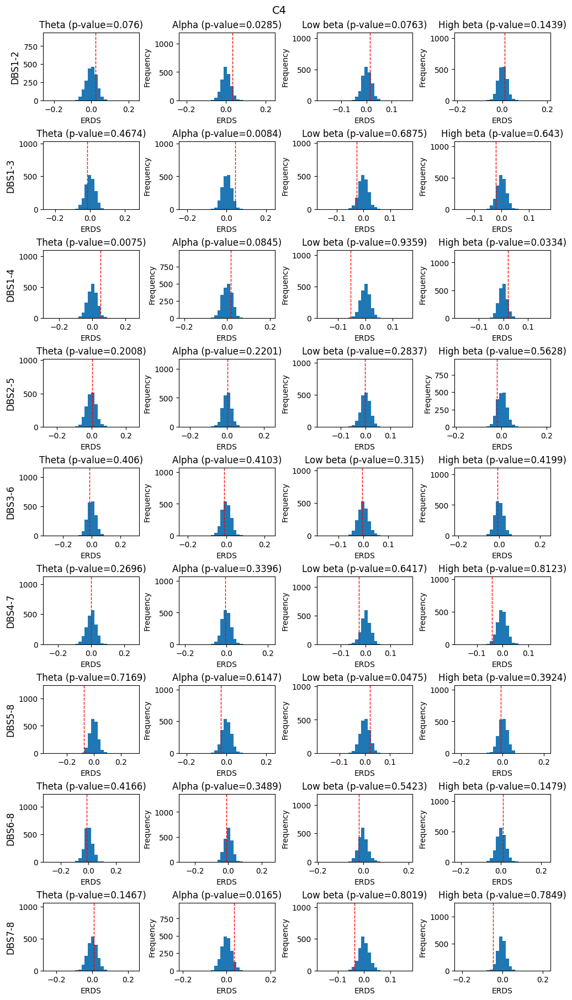

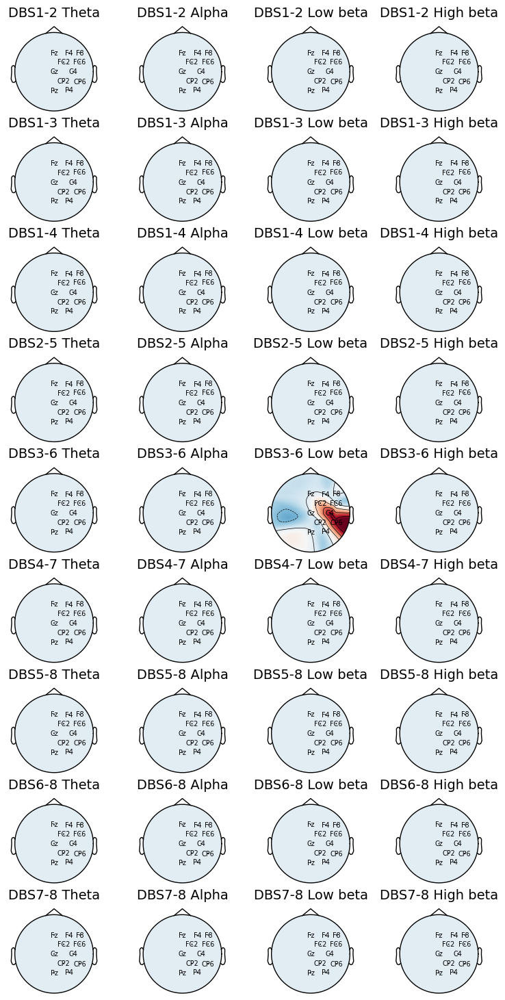

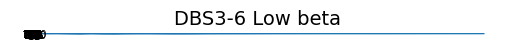

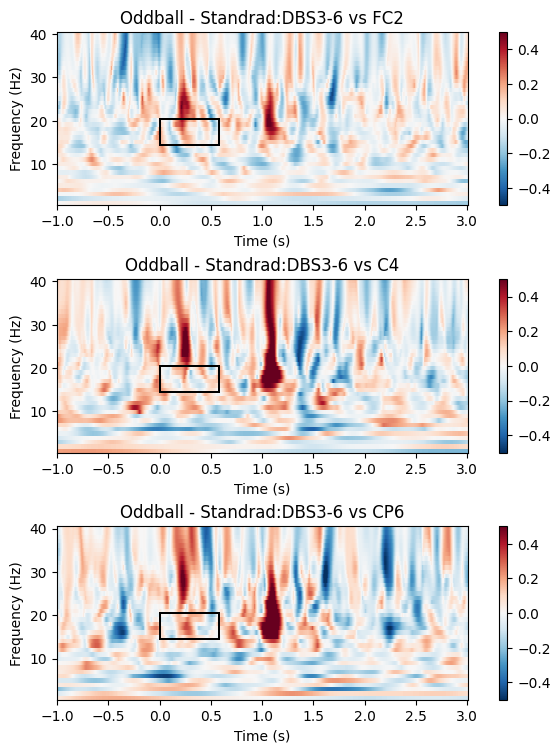

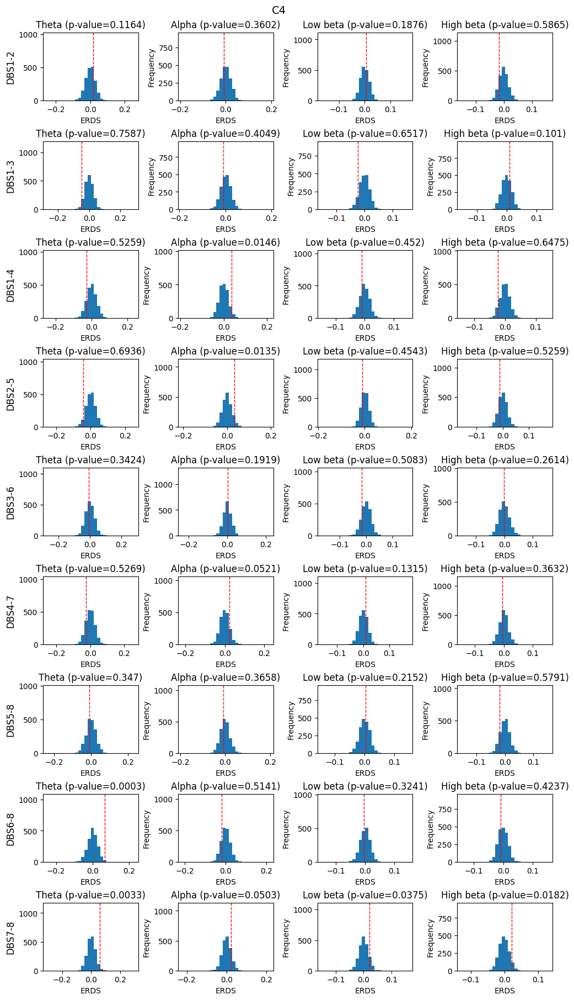

...

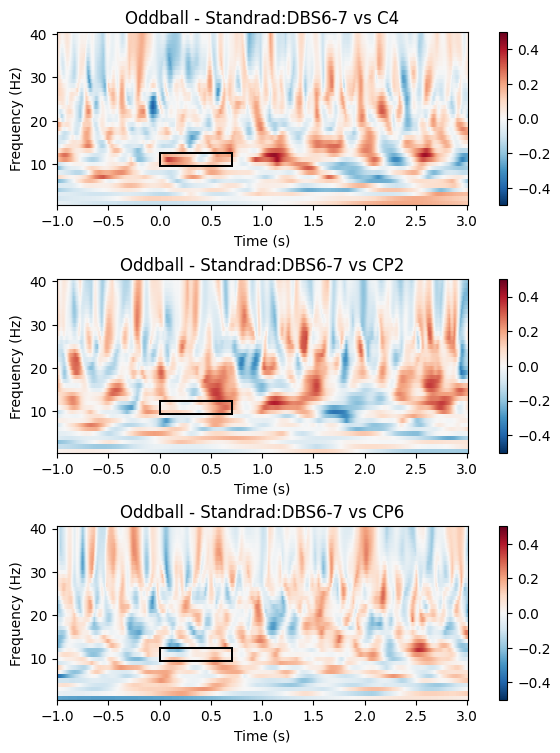

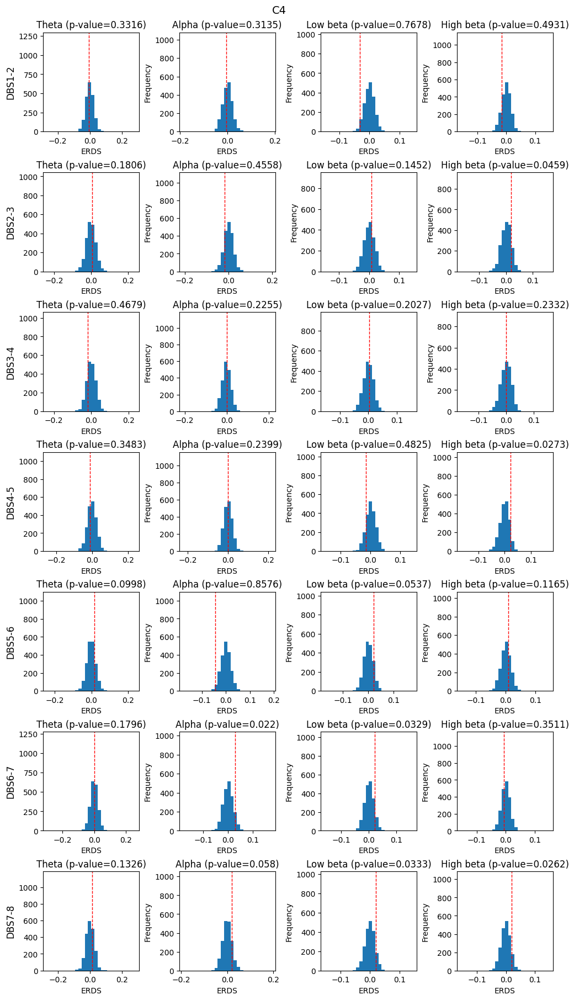

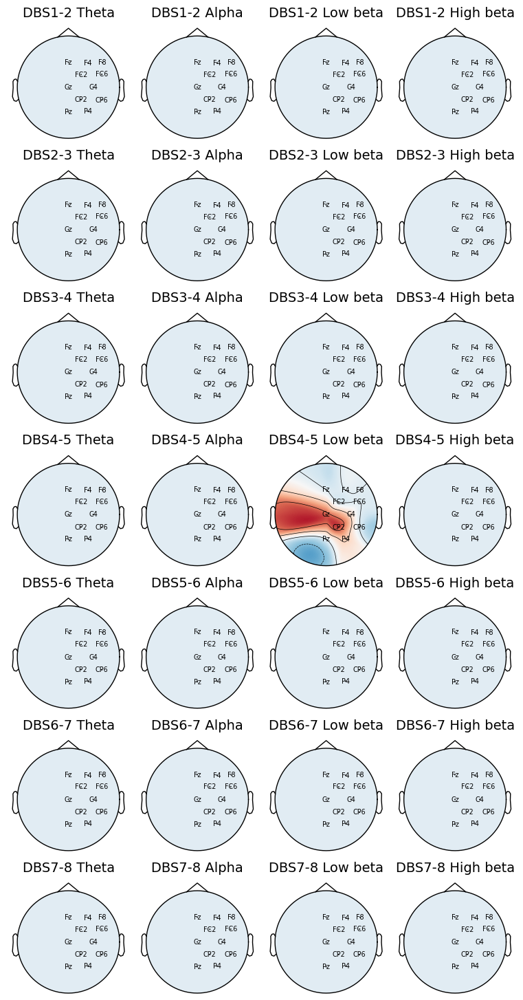

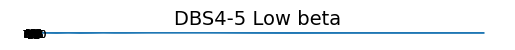

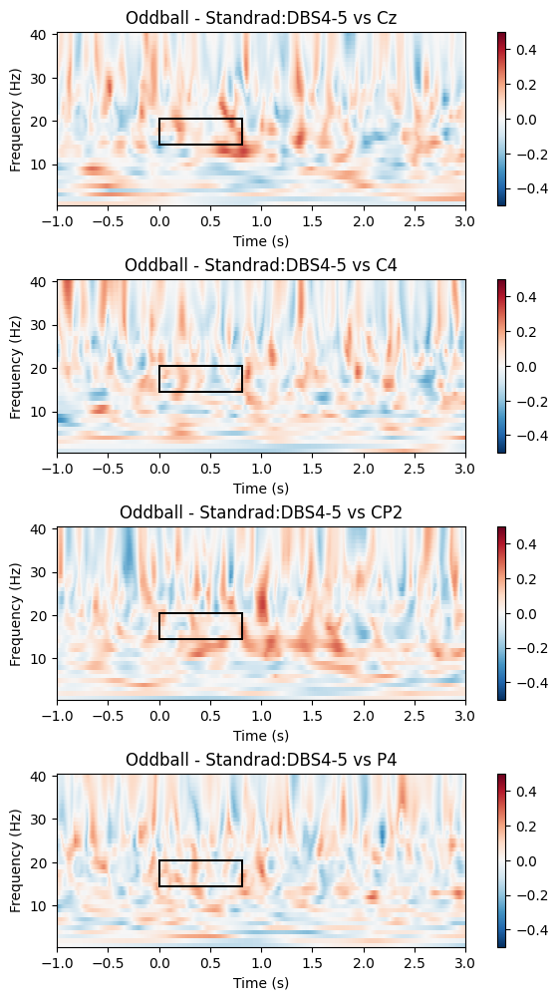

In [4]:
base_dir = "E:/Oddball Data/"
subj_list = ['007','008','011','013','014','015']

stage = ['implant','explant']#, 'implant']explant
aff_cond = ['1', '101'];
aff_cond_plot = ['Standard', 'Oddball'];

naff_cond = ['10', '110'];

for sub in subj_list:
    for st in stage:
        data_dir = base_dir+"EDEN"+sub+'/ANALYSIS/'
        fname = data_dir+"data_clean"+st+'.mat'
                
        if sub == '015' or sub=='014':
            dict1 = dict015
        elif sub == '013' and st== 'implant':
            dict1 = dict013_imp
        elif sub == '013' and st== 'explant':
            dict1 = dict013_exp
        elif sub == '011' and st== 'implant':
            dict1 = dict011_imp
        elif sub == '011' and st== 'explant':
            dict1 = dict011_exp
        elif sub == '008' and st== 'implant':
            dict1 = dict08_imp
        elif sub == '008' and st== 'explant':
            dict1 = dict08_exp
        elif sub == '007' and st== 'implant':
            dict1 = dict07_imp
        elif sub == '007' and st== 'explant':
            dict1 = dict07_exp

        info = mne.create_info(list(dict1.keys()), sfreq=200, ch_types='misc', verbose=None)
        epochs = mne.read_epochs_fieldtrip(fname,info,data_name='x', trialinfo_column=0)
        
        sfreq = epochs.info['sfreq']
        
        epochs.set_channel_types(dict1)

        kind='easycap-M1'
        mon = mne.channels.make_standard_montage(kind, head_size='auto')
        epochs.set_montage(mon,match_case=False, on_missing='ignore')
        
        epochs.filter(0.05,30)

        epochs_aff_odd = epochs[aff_cond[1]]
        epochs_aff_typ = epochs[aff_cond[0]]

        mne.epochs.equalize_epoch_counts([epochs_aff_odd,epochs_aff_typ], method='truncate')
        
        epochs_aff_odd.set_channel_types(dict_eog)
        epochs_aff_typ.set_channel_types(dict_eog)

   
        
        """Average Baseline"""
        epochs_aff_odd_norm1 =[] 
        for ii,ch in enumerate(epochs_aff_odd.ch_names):
            x = np.hstack(epochs_aff_odd.get_data()[:, ii, :]) # 2D dim = epoch* ch* time to 1D dim, freq * (time *epoch)
        
            x_mean=x.mean() # mean of all the freqs across all the complete experiment session.
            epochs_aff_odd_norm=[]    
            for jj in range(epochs_aff_odd.get_data()[:, ii, :].shape[0]):
                epochs_aff_odd_norm.append(((epochs_aff_odd.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
            epochs_aff_odd_norm1.append(epochs_aff_odd_norm)
        epochs_aff_odd_norm1 = np.array(epochs_aff_odd_norm1)
        epochs_aff_odd_norm1 = np.rollaxis(epochs_aff_odd_norm1,1) # normalized epoch data
        
        epochs_aff_odd1 = mne.EpochsArray(epochs_aff_odd_norm1,  epochs_aff_odd.info, events=epochs_aff_odd.events, tmin=epochs_aff_odd.tmin)
        
        
        """Average Baseline"""
        epochs_aff_typ_norm1 =[] 
        for ii,ch in enumerate(epochs_aff_typ.ch_names):
            x = np.hstack(epochs_aff_typ.get_data()[:, ii, :]) # 2D dim = epoch* ch* time to 1D dim, freq * (time *epoch)
        
            x_mean=x.mean() # mean of all the freqs across all the complete experiment session.
            epochs_aff_typ_norm=[]    
            for jj in range(epochs_aff_typ.get_data()[:, ii, :].shape[0]):
                epochs_aff_typ_norm.append(((epochs_aff_typ.get_data()[jj, ii, :]-x_mean)/x_mean)) # applying normalaization on each trail
            epochs_aff_typ_norm1.append(epochs_aff_typ_norm)
        epochs_aff_typ_norm1 = np.array(epochs_aff_typ_norm1)
        epochs_aff_typ_norm1 = np.rollaxis(epochs_aff_typ_norm1,1) # normalized epoch data
        
        epochs_aff_typ1 = mne.EpochsArray(epochs_aff_typ_norm1,  epochs_aff_typ.info, events=epochs_aff_typ.events, tmin=epochs_aff_typ.tmin)

        seed_chs = epochs_aff_odd1.copy().pick('dbs').ch_names

        ch_picks =['Fz','F4','F8','FC2','FC6','Cz', 'C4','CP2','CP6','Pz','P4']
        ch_picks.extend(seed_chs)
        epochs_aff_odd1.pick(ch_picks)
        epochs_aff_typ1.pick(ch_picks)
        
        
        
        
        
        
        
        
        
        tmin = -1
        tmax = 4
        Dynmo_odd = epochs_aff_odd.copy().crop(tmin,tmax).get_data(picks='DynL(lc)')
        Dynmo_odd= Dynmo_odd.reshape(Dynmo_odd.shape[0],Dynmo_odd.shape[2]).mean(axis=0)

        Dynmo_typ = epochs_aff_typ.copy().crop(tmin,tmax).get_data(picks='DynL(lc)')
        Dynmo_typ= Dynmo_typ.reshape(Dynmo_typ.shape[0],Dynmo_typ.shape[2]).mean(axis=0)


        time= epochs_aff_typ.copy().crop(-1,tmax).times

        x=np.arange(tmin,tmax,0.2)


        f_max_time = np.argmax(epochs_aff_odd.copy().crop(0,1).get_data(picks='DynL(lc)').reshape(epochs_aff_odd.copy().crop(0,1).get_data(picks='DynL(lc)').shape[0],epochs_aff_odd.copy().crop(0,1).get_data(picks='DynL(lc)').shape[2]).mean(axis=0))/200



        # Define different time windows to look for coherence in Error detection and Error correction

        tmin_coh_lst = [0, f_max_time, 0] #0 # Error detection, Error correction, Full time
        tmax_coh_lst = [f_max_time, 1.5, 1.5] #1.5
        
        
        
        file = file = f"{base_dir}coh_diff_{sub}_{st}_{tmin_coh_lst[0]}_{tmax_coh_lst[2]}_ipsi.npy"
        coh_diff = np.load(file) # Error Detection file 

        file = f"{base_dir}coh_diff_permuted_2000_{sub}_{st}_{tmin_coh_lst[0]}_{tmax_coh_lst[2]}_ipsi.npy"
        coh_diff_permuted= np.load(file)

        
        
        
        
        
        
        seed_chs = epochs_aff_odd1.copy().pick('dbs').ch_names
        chl_list = epochs_aff_odd1.copy().pick('eeg').ch_names
        freq_band = ['Theta', 'Alpha', 'Low beta', 'High beta']
        n_channels = len(epochs_aff_odd1.copy().pick('eeg').ch_names)
        chl_list = ['C4']


        fig, axes = plt.subplots(len(seed_chs), 4, figsize=(10,18),layout="constrained")

        mask = []

        for n_seed, (seed_ch, ax) in enumerate(zip(seed_chs, axes)):
            mask1 =[]
            for nfrq, band in enumerate(freq_band):

                mask2 = []
                for nchls, ch in enumerate(chl_list):


                    values, bins, _ = ax[nfrq].hist(coh_diff_permuted[:, n_seed, nfrq, nchls, :])

                    total_area = sum(np.diff(bins)*values)

                    if coh_diff[n_seed, nfrq, nchls, : ][0] <= coh_diff_permuted[:, n_seed, nfrq, nchls, :].max():

                        values, bins = np.histogram(coh_diff_permuted[:, n_seed, nfrq, nchls, :], range=(coh_diff[n_seed, nfrq, nchls, : ][0],coh_diff_permuted[:, n_seed, nfrq, nchls, :].max()))
                        right_area = sum(np.diff(bins)*values)
                        pval = right_area/total_area
                        pval_r = round(pval, 4)
                    else:
                        pval_r = 0

                    if pval <=0.05:
                        mask2.append(pval)
                    else:
                        mask2.append(0)


                    ax[nfrq].axvline(coh_diff[n_seed, nfrq, nchls, : ], color='r', linestyle='dashed', linewidth=1)
                    ax[nfrq].set_ylabel('Frequency')
                    ax[nfrq].set_xlabel('ERDS')

                    ax[nfrq].set_title(f'{band} (p-value={pval_r})' )
                    ax[nfrq].margins(1, 1)
                ax[0].set_ylabel(seed_ch, size='large')

                mask1.append(mask2)
            mask.append(mask1)
        mask = np.array(mask)
        fig.suptitle(chl_list[0], fontsize=14)
        
        
        
        
        
        seed_chs = epochs_aff_odd1.copy().pick('dbs').ch_names
        chl_list = epochs_aff_odd1.copy().pick('eeg').ch_names
        freq_band = ['Theta', 'Alpha', 'Low beta', 'High beta']

        pvals = []
        for n_seed, (seed_ch, ax) in enumerate(zip(seed_chs, axes)):
            pvals1 = [] 
            for nfrq, band in enumerate(freq_band):

                pvals2 = []
                for nchls, ch in enumerate(chl_list):

                    values, bins = np.histogram(coh_diff_permuted[:, n_seed, nfrq, nchls, :])

                    total_area = sum(np.diff(bins)*values)

                    if coh_diff[n_seed, nfrq, nchls, : ][0] <= coh_diff_permuted[:, n_seed, nfrq, nchls, :].max():

                        values, bins = np.histogram(coh_diff_permuted[:, n_seed, nfrq, nchls, :], range=(coh_diff[n_seed, nfrq, nchls, : ][0],coh_diff_permuted[:, n_seed, nfrq, nchls, :].max()))
                        right_area = sum(np.diff(bins)*values)
                        pval = right_area/total_area
                        pval_r = round(pval, 4)
                    else:
                        pval_r = 0

                    pvals2.append(pval_r)
                pvals2 = np.array(pvals2).reshape(n_channels,1)

                pvals1.append(pvals2)
            pvals.append(pvals1)
        pvals = np.array(pvals)

        
        
        
        alpha = 0.05
        pval_bonferroni = []
        pval_fdr = []
        mask_fdr = []

        for nfrq, band in enumerate(freq_band):
            pval_bonferroni1 = []
            pval_fdr1 = []
            mask_fdr1 = []

            for nchls, ch in enumerate(chl_list):
                pvals_band = pvals[:,nfrq,nchls,:]
                n_samples , n_tests = pvals_band.shape
                reject_bonferroni, p_bon = mne.stats.bonferroni_correction(pvals_band, alpha=alpha)

                reject_fdr, p_fdr = mne.stats.fdr_correction(pvals_band, alpha=alpha, method="indep")

                mask_fdr1.append(reject_fdr)
                pval_bonferroni1.append(p_bon)
                pval_fdr1.append(p_fdr)

            pval_bonferroni.append(pval_bonferroni1)
            pval_fdr.append(pval_fdr1)
            mask_fdr.append(mask_fdr1)

        pval_bonferroni = np.rollaxis(np.array(pval_bonferroni),2,0)
        pval_fdr = np.rollaxis(np.array(pval_fdr),2,0)
        mask_fdr = np.rollaxis(np.array(mask_fdr),2,0)
        
        
        

        # cluster size thresholding. Selecting clusters with more than 3 electrodes


        # check only for ipsilasional channels
        masked_coh = np.multiply(mask_fdr,coh_diff)

        mask_cluster_size = np.zeros(masked_coh.shape)
        mask_cluster_vol = np.zeros(masked_coh.shape)

        adj, names = mne.channels.find_ch_adjacency(epochs_aff_odd1.info, 'eeg')

        clus_size_thres = 1

        freq_band = ['Theta', 'Alpha', 'Low beta', 'High beta']
        min_freq = [4, 8,13,21]
        max_freq = [7, 12,20,30]
        sig_clus_vol = []
        sig_dbs_ch = []
        sig_band_ch = []
        sig_eeg_ch = []



        for n_ch, seed_ch in enumerate(seed_chs):

            n_channels = len(epochs_aff_odd.copy().pick('eeg').ch_names)
            for n, band in enumerate(freq_band):
                tfr_evoked = mne.EvokedArray(masked_coh[n_ch,n,:,:], epochs_aff_odd1.copy().pick('eeg').info)
                for n_eeg, ch_eeg in enumerate(tfr_evoked.ch_names):
                    if tfr_evoked.get_data()[n_eeg]>0.001:
                        neigh_idx = np.where(adj[n_eeg, :].toarray().ravel())[0]
                        neigh_names = [names[i] for i in neigh_idx]
                        #print(f"{tfr_evoked.ch_names[n_eeg]} is next to {neigh_names}")

                        ch_neigh_names = []

                        for n_neigh, ch_neigh in enumerate(neigh_names):
                            if tfr_evoked.copy().pick(ch_neigh).get_data()>0.001:
                                ch_neigh_names.append(ch_neigh)
                        cluster_size = len(ch_neigh_names)
                        #print(cluster_size)
                        #print(ch_neigh_names)
                        if cluster_size>=clus_size_thres:
                            mask_cluster_amp = []
                            mask_cluster_ind = []

                            print(ch_neigh_names)
                            for n_cs, cs in enumerate(ch_neigh_names):
                                cs_ind = names.index(cs)

                                #print(cs)
                                #print(cs_ind)
                                mask_cluster_size[n_ch,n,cs_ind,:] = masked_coh[n_ch,n,cs_ind,:]

                                mask_cluster_amp.append(masked_coh[n_ch,n,cs_ind,:])
                                mask_cluster_ind.append(cs_ind)
                            # volume of the cluster 
                            sig_clus_vol.append(sum(mask_cluster_amp)*len(mask_cluster_amp))
                            sig_clus_vol1 = sum(mask_cluster_amp)*len(mask_cluster_amp)
                            print(mask_cluster_ind)
                            print(sum(mask_cluster_amp))

        print(sig_clus_vol)


        for n_ch, seed_ch in enumerate(seed_chs):

            n_channels = len(epochs_aff_odd.copy().pick('eeg').ch_names)
            for n, band in enumerate(freq_band):
                tfr_evoked = mne.EvokedArray(masked_coh[n_ch,n,:,:], epochs_aff_odd1.copy().pick('eeg').info)
                for n_eeg, ch_eeg in enumerate(tfr_evoked.ch_names):
                    if tfr_evoked.get_data()[n_eeg]>0.001:
                        neigh_idx = np.where(adj[n_eeg, :].toarray().ravel())[0]
                        neigh_names = [names[i] for i in neigh_idx]
                        #print(f"{tfr_evoked.ch_names[n_eeg]} is next to {neigh_names}")

                        ch_neigh_names = []

                        for n_neigh, ch_neigh in enumerate(neigh_names):
                            if tfr_evoked.copy().pick(ch_neigh).get_data()>0.001:
                                ch_neigh_names.append(ch_neigh)
                        cluster_size = len(ch_neigh_names)
                        #print(cluster_size)
                        #print(ch_neigh_names)
                        if cluster_size>=clus_size_thres:

                            mask_cluster_amp = []
                            mask_cluster_ind = []
                            print(ch_neigh_names)
                            for n_cs, cs in enumerate(ch_neigh_names):
                                cs_ind = names.index(cs)

                                #print(cs)
                                #print(cs_ind)
                                mask_cluster_size[n_ch,n,cs_ind,:] = masked_coh[n_ch,n,cs_ind,:]

                                mask_cluster_amp.append(masked_coh[n_ch,n,cs_ind,:])
                                mask_cluster_ind.append(cs_ind)
                            # volume of the cluster 
                            sig_clus_vol1 = sum(mask_cluster_amp)*len(mask_cluster_amp)
                            #print(mask_cluster_ind)
                            if sig_clus_vol1 == max(sig_clus_vol) :
                                print(mask_cluster_ind)
                                sig_eeg_ch = mask_cluster_ind
                                for c_ind in mask_cluster_ind:
                                    mask_cluster_vol[n_ch,n,c_ind,:] = masked_coh[n_ch,n,c_ind,:]
                                    #sig_eeg_ch.append(c_ind)
                                sig_dbs_ch.append(n_ch)
                                sig_band_ch.append(n)




        # Selecting best DBS contact based on Volume of the cluster (amplitude of the cluster* number of electrodes) 

        fig, axes = plt.subplots(figsize=(7.5, 14.5), nrows=len(seed_chs), ncols=len(freq_band), layout="constrained")

        freq_band = ['Theta', 'Alpha', 'Low beta', 'High beta']
        min_freq = [4, 8,13,21]
        max_freq = [7, 12,20,30]
        mask_params = dict(marker='o', markerfacecolor='w', markeredgecolor='k',
                            linewidth=0, markersize=8)
        for n_ch, (axes_row, seed_ch) in enumerate(zip(axes, seed_chs)):

            n_channels = len(epochs_aff_odd.copy().pick('eeg').ch_names)
            for n, (ax, band) in enumerate(zip(axes_row, freq_band)):
                tfr_evoked = mne.EvokedArray(mask_cluster_vol[n_ch,n,:,:], epochs_aff_odd1.copy().pick('eeg').info)
                tfr_evoked.plot_topomap(0.0,show_names=True,size=2, vlim=(-0.8e5,1e5),cmap='RdBu_r',axes=ax,show=False, colorbar =False)
                ax.set_title("%s %s" % (seed_ch.upper(), band), fontsize=14)

                

        print(sig_dbs_ch)
        print(sig_band_ch)
        print(sig_eeg_ch)
        
        

        # Selecting best DBS contact based on Volume of the cluster (amplitude of the cluster* number of electrodes) 

        ep_all_d = np.zeros(epochs_aff_odd.copy().pick('eeg').get_data().shape[1]).reshape(epochs_aff_odd.copy().pick('eeg').get_data().shape[1],1)
        ep_all = mne.EvokedArray(ep_all_d, epochs_aff_odd.copy().pick('eeg').info)


        fig, ax = plt.subplots(1,1)
        mask_params = dict(marker='o', markerfacecolor='w', markeredgecolor='k',
                            linewidth=0, markersize=8)


        for i, n in enumerate(epochs_aff_odd1.copy().pick('eeg').ch_names):
            ep_all_d[ep_all.ch_names.index(n)] = mask_cluster_vol[sig_dbs_ch[0],sig_band_ch[0],i,:]



        tfr_evoked = mne.EvokedArray(ep_all_d, epochs_aff_odd.copy().pick('eeg').info)
        tfr_evoked.plot_topomap(0.0,show_names=True,size=2, vlim=(-0.8e5,1e5), cmap='RdBu_r', colorbar =False, show=False,image_interp='cubic', extrapolate='head', border='mean', res=64, axes = ax)

        ax.set_title(f"{epochs_aff_odd1.copy().pick(['dbs']).ch_names[sig_dbs_ch[0]]} {freq_band[sig_band_ch[0]]}", fontsize=14)

        
        
        
        


        """"Coherence"""

        sig_dbs_ch
        sig_eeg_ch

        sig_eeg = []
        for n, i in enumerate(sig_eeg_ch):
            sig_eeg.append(epochs_aff_odd1.copy().pick(['eeg']).ch_names[sig_eeg_ch[n]])


        sig_seed_ch = [epochs_aff_odd1.copy().pick(['dbs']).ch_names[sig_dbs_ch[0]]]

        picks = mne.pick_types(epochs_aff_odd1.info, eeg=True, dbs=True, emg= False,stim=False, eog=False,
                               exclude='bads')

        epochs_aff_odd1.pick(['eeg','dbs'])
        epochs_aff_typ1.pick(['eeg','dbs'])

        # Use 'DBS' channels as seed

        coh_diff = []
        for seed_ch in sig_seed_ch:

            picks_ch_names = epochs_aff_odd1.ch_names
            # Create seed-target indices for connectivity computation
            seed = picks_ch_names.index(seed_ch)
            targets = np.arange(len(picks))
            indices = seed_target_indices(seed, targets)

            min_freq = (4, 8,13,21)
            max_freq = (7, 12,20,30)


            # Define wavelet frequencies and number of cycles
            cwt_freqs = np.arange(1, 41, 1)
            cwt_n_cycles = 7

            # Run the connectivity analysis using n parallel jobs
            con_odd = spectral_connectivity_epochs(
                epochs_aff_odd1, indices=indices,
                method='coh', mode='cwt_morlet', sfreq=sfreq, 
                cwt_freqs=cwt_freqs, cwt_n_cycles=cwt_n_cycles, n_jobs=2)

            con_typ = spectral_connectivity_epochs(
                epochs_aff_typ1, indices=indices,
                method='coh', mode='cwt_morlet', sfreq=sfreq, 
                cwt_freqs=cwt_freqs, cwt_n_cycles=cwt_n_cycles, n_jobs=2)

            times = con_odd.times
            freqs = con_odd.freqs

            # Mark the seed channel with a value of 1.0, so we can see it in the plot
            # con_odd.get_data()[np.where(indices[1] == seed)] = 1.0
            # con_typ.get_data()[np.where(indices[1] == seed)] = 1.0

            #layout = mne.find_layout(epochs.info, 'eeg')  # use full layout
            tfr_odd = mne.time_frequency.AverageTFR(epochs_aff_odd1.info, con_odd.get_data(), times, freqs, len(epochs_aff_odd1))
            #tfr_odd.save(data_dir+'tfr_odd'+st+seed_ch+'-tfr.h5',overwrite =True)

            tfr_typ = mne.time_frequency.AverageTFR(epochs_aff_typ1.info, con_typ.get_data(), times, freqs, len(epochs_aff_typ1))
            #tfr_typ.save(data_dir+'tfr_typ'+st+seed_ch+'-tfr.h5',overwrite =True)

            # TFR differences in freq bands and time period 0 to 1.5s

            tfr_diff = tfr_odd- tfr_typ
            
            

        CCC = tfr_diff.copy().pick(sig_eeg).data.mean(axis=0)
        file = f"{base_dir}CCC_diff_{sub}_{st}"
        np.save(file,CCC)

        CCC_odd = tfr_odd.copy().pick(sig_eeg).data.mean(axis=0)
        file = f"{base_dir}CCC_Oddball_{sub}_{st}"
        np.save(file,CCC_odd)

        CCC_typ = tfr_typ.copy().pick(sig_eeg).data.mean(axis=0)
        file = f"{base_dir}CCC_Standard_{sub}_{st}"
        np.save(file,CCC_typ)

        plt.plot(CCC_typ.mean(axis=1))
            

            
            
        # creating a mask to plot on tfr coherence betwwn 0s and 1.5s and significant freq band
        tmin = -1
        tmax = 3

        tmin_mark = tmin_coh_lst[0]
        tmax_mark = tmax_coh_lst[0]
        fmin_mark = min_freq[sig_band_ch[0]]
        fmax_mark = max_freq[sig_band_ch[0]]

        mask_tfr_diff = np.full(tfr_diff.copy().crop(tmin,tmax).pick(sig_eeg).data.shape, False)


        for n in range(0,tfr_diff.copy().crop(tmin,tmax).data.shape[1]):
            for m in range(0,tfr_diff.copy().crop(tmin,tmax).data.shape[2]):
                if n>fmin_mark and n<fmax_mark and m > (tmin_mark-tmin)*200 and m < (tmax_mark-tmin)*200:
                    mask_tfr_diff[:,n,m]= True

        vmax=0.5
        vmin=-0.5
        fig, axes = plt.subplots(figsize=(5.5, 2.5*len(sig_eeg_ch)), nrows=len(sig_eeg_ch), ncols=1, layout="constrained")

        if len(sig_eeg_ch)>1:
            for i, (ax, ch) in enumerate(zip(axes, tfr_diff.copy().pick(sig_eeg).ch_names)):
                title = 'Oddball - Standrad:' + seed_ch +' vs '+ch 
                tfr_diff.plot(ch, tmin=tmin,tmax=tmax, axes = ax, vmax=vmax,vmin=vmin, mask =mask_tfr_diff[i,:,:] ,mask_style = 'contour', show= False)
                ax.set_title(title)
        else:
            title = 'Oddball - Standrad:' + seed_ch +' vs '+ sig_eeg[0]
            tfr_diff.plot(sig_eeg[0], tmin=tmin,tmax=tmax, axes = axes, vmax=vmax,vmin=vmin, mask =mask_tfr_diff[0,:,:] ,mask_style = 'contour', show= False)
            axes.set_title(title)

            


        df = tfr_typ.copy().pick(sig_eeg).to_data_frame(time_format=None, long_format=True)

        # Map to frequency bands:
        freq_bounds = {"_": 0, "[0 3]": 4, "[4 7]": 8, "[8 12]": 13, "[13 20]": 20, "[21 30]": 30}
        time_bounds = {"_": -0.5, "[-0.5 0]": 0, f'[0 {f_max_time} ]': f_max_time, f'[{f_max_time} 1.1]': 1.1, "[1.1, 1.5]": 1.5, "[1.5 2]": 2}

        df["band"] = pd.cut(
            df["freq"], list(freq_bounds.values()), labels=list(freq_bounds)[1:]
        )

        df["Time_dur"] = pd.cut(
            df["time"], list(time_bounds.values()), labels=list(time_bounds)[1:]
        )

        # Filter to retain only relevant frequency bands:
        freq_bands_of_interest = ["[4 7]","[8 12]", "[13 20]", "[21 30]"]
        time_of_interest = ["[-0.5 0]", f'[0 {f_max_time} ]', f'[{f_max_time} 1.1]', "[1.1, 1.5]", "[1.5 2]"]

        df = df[df.band.isin(freq_bands_of_interest)]
        df = df[df.Time_dur.isin(time_of_interest)]

        df["band"] = df["band"].cat.remove_unused_categories()
        df["Time_dur"] = df["Time_dur"].cat.remove_unused_categories()


        df_mean = (
            df.groupby(["Time_dur", "band", "channel"], observed=False)[["value"]]
            .mean()
            .reset_index()
        )
        df_mean.insert(0,'Stage', len(df_mean)*[st])
        df_mean.insert(1,'Subject', len(df_mean)*[sub])
        df_mean.insert(2,'Condition', len(df_mean)*['Standard'])
        df_mean.insert(5,'DBS Channel', len(df_mean)*[sig_seed_ch])

        df_mean.to_csv(base_dir+'Oddball_Coh_data.csv', mode='a', index=False, header=False)
        
        
        
        
        df = tfr_odd.copy().pick(sig_eeg).to_data_frame(time_format=None, long_format=True)

        # Map to frequency bands:
        freq_bounds = {"_": 0, "[0 3]": 4, "[4 7]": 8, "[8 12]": 13, "[13 20]": 20, "[21 30]": 30}
        time_bounds = {"_": -0.5, "[-0.5 0]": 0, f'[0 {f_max_time} ]': f_max_time, f'[{f_max_time} 1.1]': 1.1, "[1.1, 1.5]": 1.5, "[1.5 2]": 2}

        df["band"] = pd.cut(
            df["freq"], list(freq_bounds.values()), labels=list(freq_bounds)[1:]
        )

        df["Time_dur"] = pd.cut(
            df["time"], list(time_bounds.values()), labels=list(time_bounds)[1:]
        )

        # Filter to retain only relevant frequency bands:
        freq_bands_of_interest = ["[4 7]","[8 12]", "[13 20]", "[21 30]"]
        time_of_interest = ["[-0.5 0]", f'[0 {f_max_time} ]', f'[{f_max_time} 1.1]', "[1.1, 1.5]", "[1.5 2]"]

        df = df[df.band.isin(freq_bands_of_interest)]
        df = df[df.Time_dur.isin(time_of_interest)]

        df["band"] = df["band"].cat.remove_unused_categories()
        df["Time_dur"] = df["Time_dur"].cat.remove_unused_categories()


        df_mean = (
            df.groupby(["Time_dur", "band", "channel"], observed=False)[["value"]]
            .mean()
            .reset_index()
        )
        df_mean.insert(0,'Stage', len(df_mean)*[st])
        df_mean.insert(1,'Subject', len(df_mean)*[sub])
        df_mean.insert(2,'Condition', len(df_mean)*['Oddball'])
        df_mean.insert(5,'DBS Channel', len(df_mean)*[sig_seed_ch])


        df_mean.to_csv(base_dir+'Oddball_Coh_data.csv', mode='a', index=False, header=False)

